# Telecom Churn - Assignment | Code Document 
## Author - Jatin Arora

### arorjati@gmail.com

## Problem Statement

# Approach

I am approaching this exercise in stages:
1. Data Import
2. Data Analysis - EDA
    - Data Preparation 
    - Preliminary Analysis
    - Univariate Analysis
    - Multivariate Analysis

4. Feature Engineering
5. Modelling
    -Mental Model Preparation
    - Unsupervised Approach
    - Supervised Approach
6. Validation & Model Selection

# Stage 1
### Libarary Import

In [1]:
#Import Libararies
import numpy as np
import pandas as pd
import os
import sklearn

from matplotlib import pyplot as plt
import seaborn as sns
from scipy import stats
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

### Reading Data

In [2]:
data_cols = ['id', 'state', 'acc_len', 'area_code', 'int_plan', 'voice_mail_plan', 'num_vmail_msg', 'total_day_minutes',
"total_day_calls", "total_day_charge", "total_eve_min", "total_eve_calls", "total_eve_charge", "total_night_min",
"total_night_calls", "total_night_charge", "total_int_min", "total_int_calls", "total_int_charge", "customer_service_calls",
"churn"]

num_data = ['acc_len', 'num_vmail_msg', 'total_day_minutes',
"total_day_calls", "total_day_charge", "total_eve_min", "total_eve_calls", "total_eve_charge", "total_night_min",
"total_night_calls", "total_night_charge", "total_int_min", "total_int_calls", "total_int_charge", "customer_service_calls"]

cat_data = ['state', 'area_code', 'int_plan', 'voice_mail_plan']

target =['churn']

In [3]:
data_link = "/local/home/arorjati/"
data = "data.csv"
data = pd.read_csv(data_link+data, header = 0, names = data_cols)
data.head()

,id,state,acc_len,area_code,int_plan,voice_mail_plan,num_vmail_msg,total_day_minutes,total_day_calls,total_day_charge,...,total_eve_calls,total_eve_charge,total_night_min,total_night_calls,total_night_charge,total_int_min,total_int_calls,total_int_charge,customer_service_calls,churn
0,CUST-1,KS,128,415,No,Yes,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,CUST-2,OH,107,415,No,Yes,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,CUST-3,NJ,137,415,No,No,0,243.4,114,41.38,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,CUST-4,OH,84,408,Yes,No,0,299.4,71,50.90,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,CUST-5,OK,75,415,Yes,No,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


# Stage 2

### 2.1 Data Preparation

### Data Munging 

In [4]:
# checking Null Values or missing values
data.isnull().sum()

id                        0
state                     0
acc_len                   0
area_code                 0
int_plan                  0
voice_mail_plan           0
num_vmail_msg             0
total_day_minutes         0
total_day_calls           0
total_day_charge          0
total_eve_min             0
total_eve_calls           0
total_eve_charge          0
total_night_min           0
total_night_calls         0
total_night_charge        0
total_int_min             0
total_int_calls           0
total_int_charge          0
customer_service_calls    0
churn                     0
dtype: int64

In [5]:
#data shape
print(data.shape) #(3333, 21)

#unique customers
print(len(data['id'].unique())) #3333

print(data.groupby('churn').size().reset_index)
# False    2850
# True      483

#unique int_plan
print(len(data['int_plan'].unique())) #2

#unique voice_mail_plan
print(len(data['voice_mail_plan'].unique())) #2

data['churn'].unique()

(3333, 21)
3333
<bound method Series.reset_index of churn
False    2850
True      483
dtype: int64>
2
2


array([False,  True])

In [6]:
#converting categorical to numerical data
data['int_plan'] = np.where(data['int_plan'] == "No", 0,1)
data['voice_mail_plan'] = np.where(data['voice_mail_plan'] == "No", 0,1)

## 2.2 Preliminary Analysis

In [7]:
#data at glance
describe_data = data.describe()
describe_data.to_csv("describe_data.csv")
describe_data.head()

,acc_len,area_code,int_plan,voice_mail_plan,num_vmail_msg,total_day_minutes,total_day_calls,total_day_charge,total_eve_min,total_eve_calls,total_eve_charge,total_night_min,total_night_calls,total_night_charge,total_int_min,total_int_calls,total_int_charge,customer_service_calls
count,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000
mean,101.064806,437.182418,0.096910,0.276628,8.099010,179.775098,100.435644,30.562307,200.980348,100.114311,17.083540,200.872037,100.107711,9.039325,10.237294,4.479448,2.764581,1.562856
std,39.822106,42.371290,0.295879,0.447398,13.688365,54.467389,20.069084,9.259435,50.713844,19.922625,4.310668,50.573847,19.568609,2.275873,2.791840,2.461214,0.753773,1.315491
min,1.000000,408.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000
25%,74.000000,408.000000,0.000000,0.000000,0.000000,143.700000,87.000000,24.430000,166.600000,87.000000,14.160000,167.000000,87.000000,7.520000,8.500000,3.000000,2.300000,1.000000


In [8]:
#data w.r.t the target variable
churn_describe = data.groupby('churn').describe()
churn_describe.to_csv("churn_describe.csv")
churn_describe.head()

acc_len                                                       area_code  \
        count        mean       std  min   25%    50%    75%    max     count   
churn                                                                           
False  2850.0  100.793684  39.88235  1.0  73.0  100.0  127.0  243.0    2850.0   
True    483.0  102.664596  39.46782  1.0  76.0  103.0  127.0  225.0     483.0   

                  ...  total_night_min        voice_mail_plan            \
             mean ...              75%    max           count      mean   
churn             ...                                                     
False  437.074737 ...           234.90  395.0          2850.0  0.295439   
True   437.817805 ...           239.85  354.9           483.0  0.165631   

                                          
            std  min  25%  50%  75%  max  
churn                                     
False  0.456320  0.0  0.0  0.0  1.0  1.0  
True   0.372135  0.0  0.0  0.0  0.0  1.0  

[2 rows x 144 columns]

## 2.3 Univariate Analysis

In [9]:
data.columns

Index(['id', 'state', 'acc_len', 'area_code', 'int_plan', 'voice_mail_plan',
       'num_vmail_msg', 'total_day_minutes', 'total_day_calls',
       'total_day_charge', 'total_eve_min', 'total_eve_calls',
       'total_eve_charge', 'total_night_min', 'total_night_calls',
       'total_night_charge', 'total_int_min', 'total_int_calls',
       'total_int_charge', 'customer_service_calls', 'churn'],
      dtype='object')

### Plots

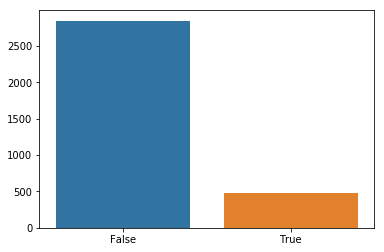

In [10]:
sns.barplot(data["churn"].value_counts().index, data["churn"].value_counts().values)
plt.savefig("churn.png")
#class - imbalance

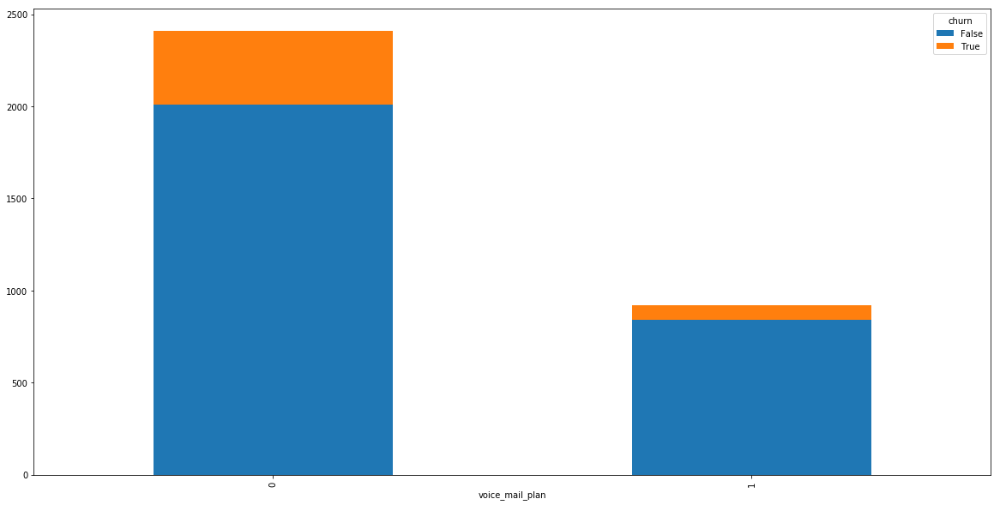

In [11]:
data.groupby(["voice_mail_plan", "churn"]).size().unstack().plot(kind='bar', stacked=True, figsize=(20,10))

pd.crosstab(data['voice_mail_plan'], data['churn'])

plt.savefig("v_mail_churn.png")

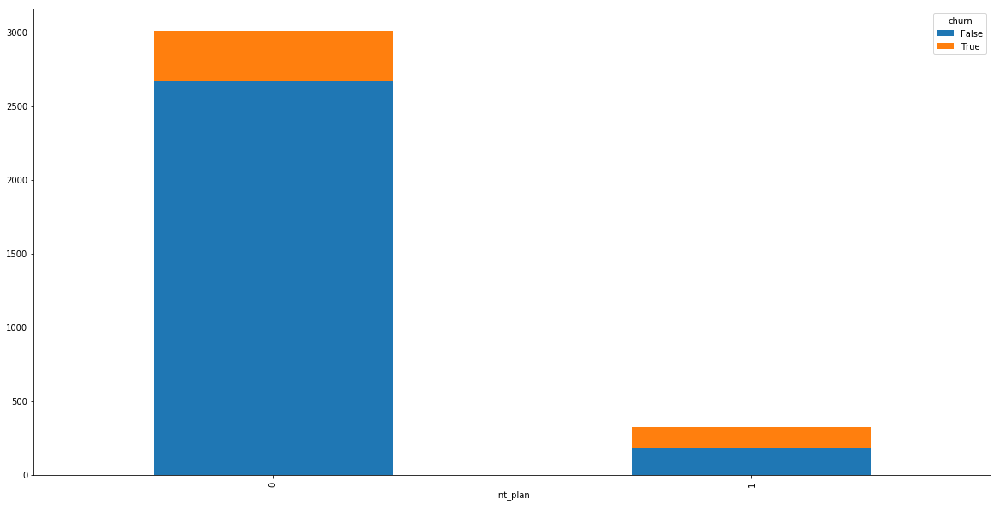

In [12]:
data.groupby(["int_plan", "churn"]).size().unstack().plot(kind='bar', stacked=True, figsize=(20,10))

pd.crosstab(data['int_plan'], data['churn'])
plt.savefig("int_plan_churn.png")

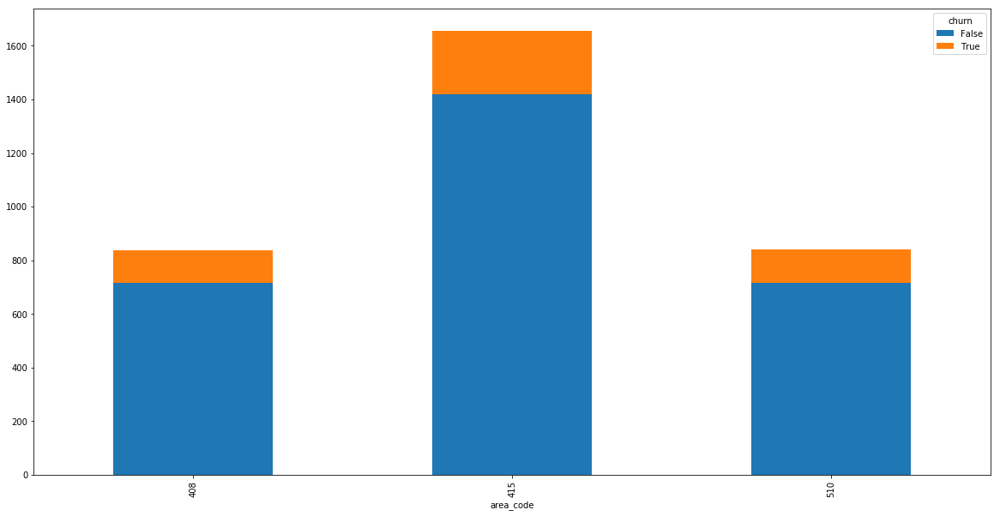

In [13]:
data.groupby(["area_code", "churn"]).size().unstack().plot(kind='bar', stacked=True, figsize=(20,10))

pd.crosstab(data['area_code'], data['churn'])
plt.savefig("area_code_churn.png")


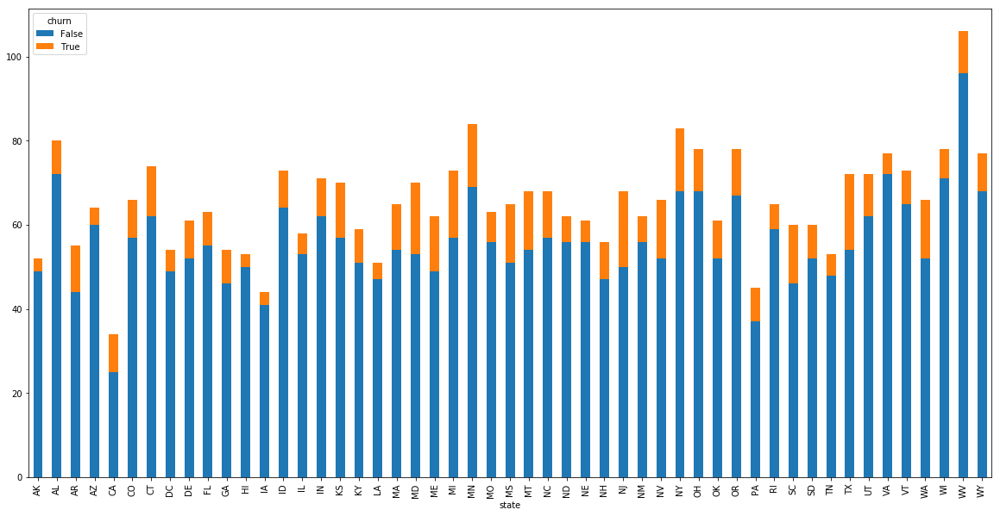

In [14]:
data.groupby(["state", "churn"]).size().unstack().plot(kind='bar', stacked=True, figsize=(20,10))

pd.crosstab(data['state'], data['churn']).transpose()
plt.savefig("state_churn.png")


## 2.4 Multivariate Analysis

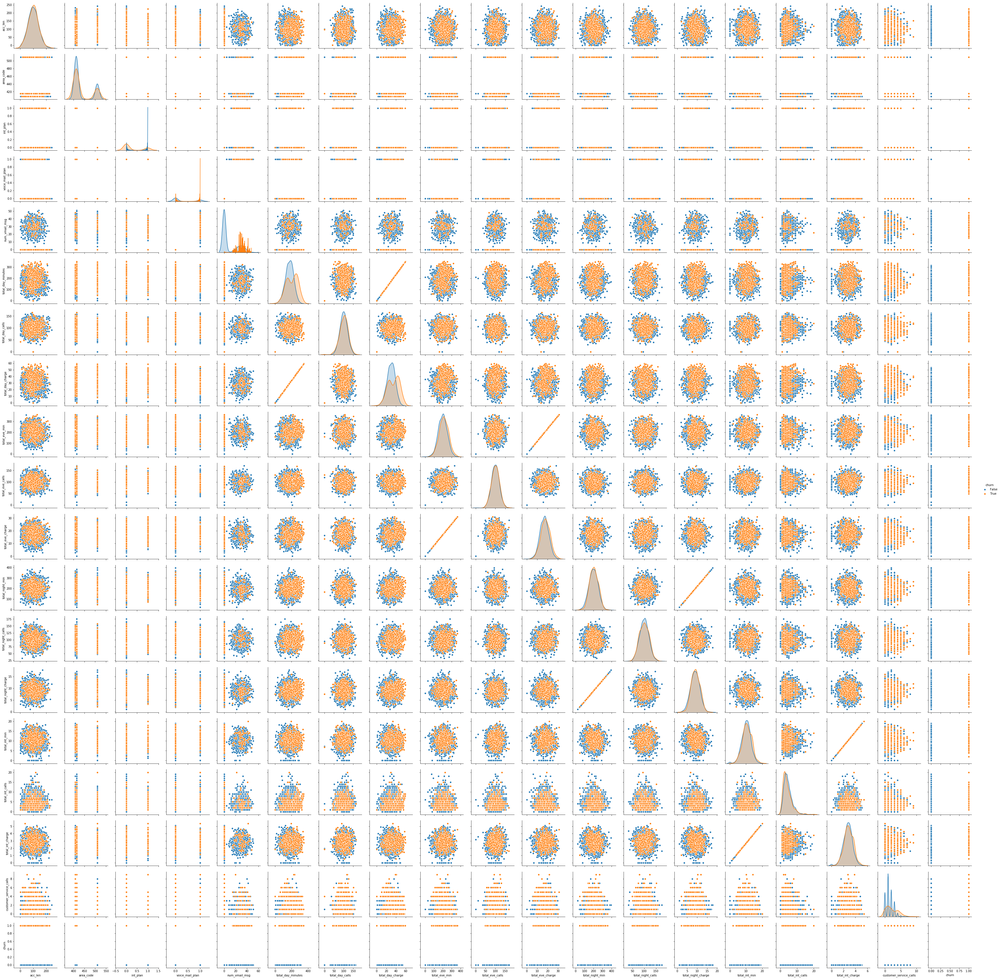

In [15]:
sns.pairplot(data, hue = 'churn')
plt.savefig("corr_1.png")

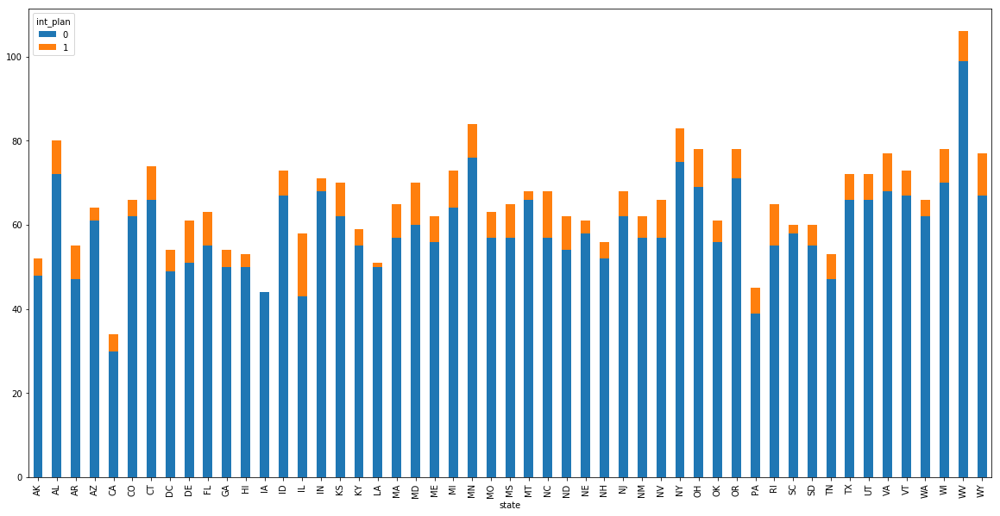

In [16]:
data.groupby(["state", "int_plan"]).size().unstack().plot(kind='bar', stacked=True, figsize=(20,10))
plt.savefig('state__int_plan.png')

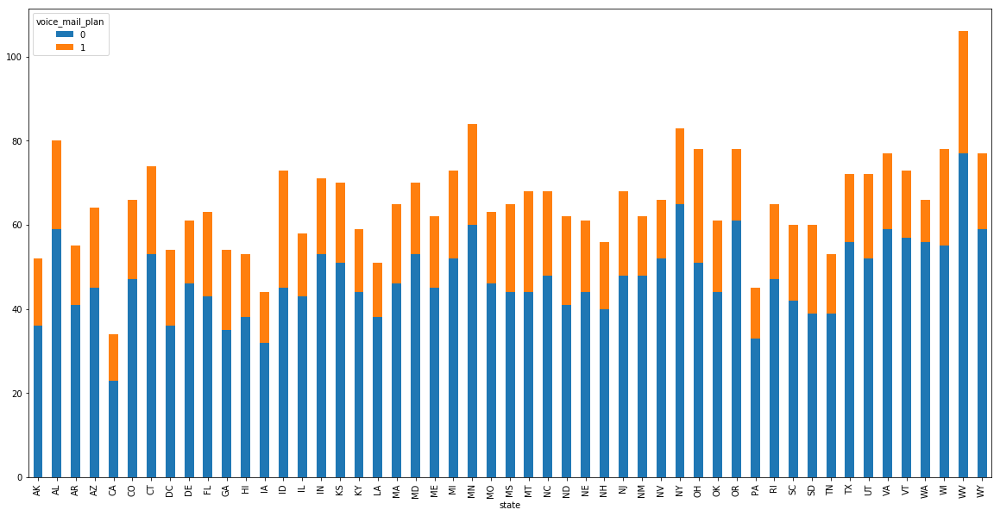

In [17]:
data.groupby(["state", "voice_mail_plan"]).size().unstack().plot(kind='bar', stacked=True, figsize=(20,10))
plt.savefig('state__voice_mail_plan.png')

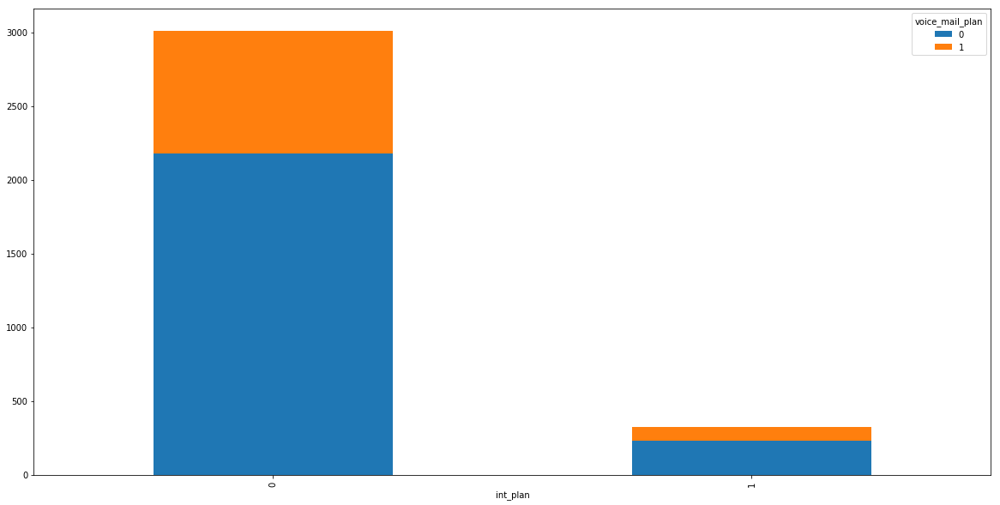

In [18]:
data.groupby(["int_plan", "voice_mail_plan"]).size().unstack().plot(kind='bar', stacked=True, figsize=(20,10))
plt.savefig("int_vmail.png")

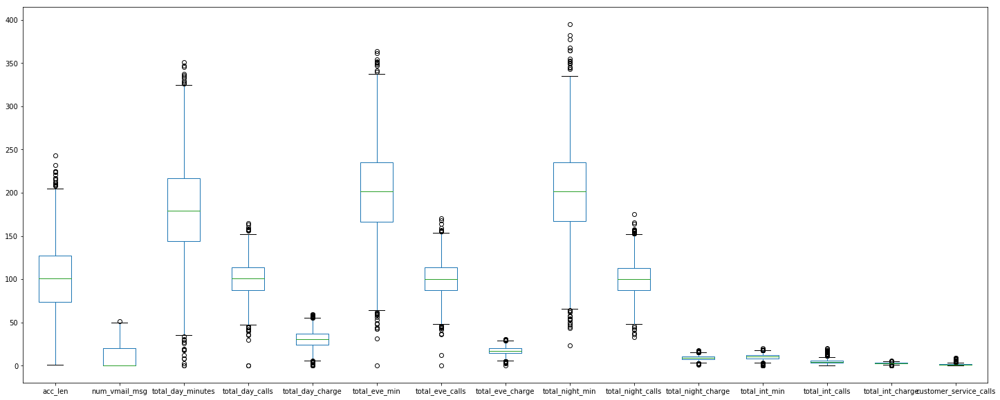

In [19]:
#box-whisker plot
data[num_data].plot(kind='box', subplots=False, figsize=(25,10))
plt.savefig("box_plot.png")
plt.show()

In [20]:
data.corr()['churn'].sort_values(ascending=False)

churn                     1.000000
int_plan                  0.259852
customer_service_calls    0.208750
total_day_minutes         0.205151
total_day_charge          0.205151
total_eve_min             0.092796
total_eve_charge          0.092786
total_int_charge          0.068259
total_int_min             0.068239
total_night_charge        0.035496
total_night_min           0.035493
total_day_calls           0.018459
acc_len                   0.016541
total_eve_calls           0.009233
area_code                 0.006174
total_night_calls         0.006141
total_int_calls          -0.052844
num_vmail_msg            -0.089728
voice_mail_plan          -0.102148
Name: churn, dtype: float64

# Stage 3. Feature Engineering

In [21]:
data.columns

Index(['id', 'state', 'acc_len', 'area_code', 'int_plan', 'voice_mail_plan',
       'num_vmail_msg', 'total_day_minutes', 'total_day_calls',
       'total_day_charge', 'total_eve_min', 'total_eve_calls',
       'total_eve_charge', 'total_night_min', 'total_night_calls',
       'total_night_charge', 'total_int_min', 'total_int_calls',
       'total_int_charge', 'customer_service_calls', 'churn'],
      dtype='object')

In [22]:
dummies = pd.get_dummies(data['area_code'], prefix="area_code")
dummies.head()
data = pd.concat([data,dummies], axis=1)
data.head()

,id,state,acc_len,area_code,int_plan,voice_mail_plan,num_vmail_msg,total_day_minutes,total_day_calls,total_day_charge,...,total_night_calls,total_night_charge,total_int_min,total_int_calls,total_int_charge,customer_service_calls,churn,area_code_408,area_code_415,area_code_510
0,CUST-1,KS,128,415,0,1,25,265.1,110,45.07,...,91,11.01,10.0,3,2.70,1,False,0,1,0
1,CUST-2,OH,107,415,0,1,26,161.6,123,27.47,...,103,11.45,13.7,3,3.70,1,False,0,1,0
2,CUST-3,NJ,137,415,0,0,0,243.4,114,41.38,...,104,7.32,12.2,5,3.29,0,False,0,1,0
3,CUST-4,OH,84,408,1,0,0,299.4,71,50.90,...,89,8.86,6.6,7,1.78,2,False,1,0,0
4,CUST-5,OK,75,415,1,0,0,166.7,113,28.34,...,121,8.41,10.1,3,2.73,3,False,0,1,0


In [23]:
num_data = ['acc_len', 'prem_customer','int_plan', 'voice_mail_plan','num_vmail_msg', 'total_day_minutes', 'total_day_calls',
       'total_day_charge', 'total_eve_min', 'total_eve_calls',
       'total_eve_charge', 'total_night_min', 'total_night_calls',
       'total_night_charge', 'total_int_min', 'total_int_calls',
       'total_int_charge', 'customer_service_calls',
       'day_avg_charge', 'eve_avg_charge', 'night_avg_charge', 'total_calls',
       'total_charge', 'total_min', 'day_avg_charge[data]',
       'eve_avg_charge[data]', 'night_avg_charge[data]',
       'day_avg_charge[data_state]', 'eve_avg_charge[data_state]',
       'night_avg_charge[data_state]', 'day_avg_charge[data_area_code]',
       'eve_avg_charge[data_area_code]', 'night_avg_charge[data_area_code]',
       'deviation_day_charge_state', 'deviation_eve_charge_state',
       'deviation_night_charge_state', 'deviation_day_charge_area_code',
       'deviation_eve_charge_area_code', 'cus_dev_day_charge',
       'cus_dev_eve_charge', 'cus_dev_night_charge', 'area_code_408', 'area_code_415', 'area_code_510']

cat_data = ['id', 'state']

target_data = ['churn']

In [24]:
#feature generation by business intelligence

#defining the customer as premium customer if he/she is availing bpth the internation plan and voice mail plan
data['prem_customer'] = np.where((data['int_plan'] == 1) & (data['voice_mail_plan'] == 1), 1,0)
#calculating the day average charge for day calls
data['day_avg_charge'] = data["total_day_charge"]/data["total_day_calls"]
#calculating the day average charge for evening calls
data['eve_avg_charge'] = data["total_eve_charge"]/data["total_eve_calls"]
#calculating the day average charge for night calls
data['night_avg_charge'] = data["total_night_charge"]/data["total_night_calls"]

#total calls made by the customer
data['total_calls']= data['total_day_calls'] + data['total_eve_calls'] + data['total_night_calls'] + data['total_int_calls'] + data['customer_service_calls']

#total charge to the customer
data['total_charge']= data['total_day_charge'] + data['total_eve_charge'] + data['total_night_charge'] + data['total_int_charge']

#total call minutes
data['total_min']= data['total_day_minutes'] + data['total_eve_min'] + data['total_night_min'] + data['total_int_min']


data['day_avg_charge[data]'] = data["total_day_charge"].mean()
#calculating the day average charge for evening calls
data['eve_avg_charge[data]'] = data["total_eve_charge"].mean()
#calculating the day average charge for night calls
data['night_avg_charge[data]'] = data["total_night_charge"].mean()

data = data.merge(data.groupby(["state"])["total_day_charge"].mean().reset_index().rename(columns = {'state': 'state',"total_day_charge":"day_avg_charge[data_state]"})
                                                , on = ['state'])

data = data.merge(data.groupby(["state"])["total_eve_charge"].mean().reset_index().rename(columns = {'state': 'state',"total_eve_charge":"eve_avg_charge[data_state]"})
                                                , on = ['state'])

data = data.merge(data.groupby(["state"])["total_night_charge"].mean().reset_index().rename(columns = {'state': 'state',"total_night_charge":"night_avg_charge[data_state]"})
                                                , on = ['state'])


data = data.merge(data.groupby(["area_code"])["total_day_charge"].mean().reset_index().rename(columns = {'area_code': 'area_code',"total_day_charge":"day_avg_charge[data_area_code]"})
                                                , on = ['area_code'])

data = data.merge(data.groupby(["area_code"])["total_eve_charge"].mean().reset_index().rename(columns = {'area_code': 'area_code',"total_eve_charge":"eve_avg_charge[data_area_code]"})
                                                , on = ['area_code'])

data = data.merge(data.groupby(["area_code"])["total_night_charge"].mean().reset_index().rename(columns = {'area_code': 'area_code',"total_night_charge":"night_avg_charge[data_area_code]"})
                                                , on = ['area_code'])

In [25]:
data["deviation_day_charge_state"] = (data["day_avg_charge[data_state]"]/data["day_avg_charge[data]"])-1
data["deviation_eve_charge_state"] = (data["eve_avg_charge[data_state]"]/data["eve_avg_charge[data]"])-1
data["deviation_night_charge_state"] = (data["night_avg_charge[data_state]"]/data["night_avg_charge[data]"])-1

data["deviation_day_charge_area_code"] = (data["day_avg_charge[data_area_code]"]/data["day_avg_charge[data]"])-1
data["deviation_eve_charge_area_code"] = (data["eve_avg_charge[data_area_code]"]/data["eve_avg_charge[data]"])-1
data["deviation_eve_charge_area_code"] = (data["night_avg_charge[data_area_code]"]/data["night_avg_charge[data]"])-1

In [26]:
data['cus_dev_day_charge'] = (data['total_day_charge']/data['day_avg_charge[data]'])-1
data['cus_dev_eve_charge'] = (data['total_eve_charge']/data['eve_avg_charge[data]'])-1
data['cus_dev_night_charge'] = (data['total_night_charge']/data['night_avg_charge[data]'])-1

In [27]:
data.to_csv('featured_data.csv')

In [28]:
sns.pairplot(data, hue = 'churn')
plt.savefig("corr_2.png")

In [29]:
sns.pairplot(data, hue = 'prem_customer')
plt.savefig("corr3.png")

In [30]:
sns.pairplot(data, hue = 'churn')
plt.savefig("corr4.png")

In [31]:
data.groupby(['area_code']).describe()

acc_len                                                         \
            count        mean        std  min   25%    50%    75%    max   
area_code                                                                  
408         838.0  101.877088  40.393825  1.0  74.0  102.0  130.0  232.0   
415        1655.0  101.068882  39.256637  1.0  74.0  100.0  126.0  225.0   
510         840.0  100.246429  40.381347  3.0  72.0  100.0  128.0  243.0   

          area_code_408      ...  total_night_min        voice_mail_plan  \
                  count mean ...              75%    max           count   
area_code                    ...                                           
408               838.0  1.0 ...           236.15  367.7           838.0   
415              1655.0  0.0 ...           236.30  381.9          1655.0   
510               840.0  0.0 ...           232.70  395.0           840.0   

                                                        
               mean       std  min  25%  50%  75%  max  
area_code                                               
408        0.262530  0.440272  0.0  0.0  0.0  1.0  1.0  
415        0.284592  0.451356  0.0  0.0  0.0  1.0  1.0  
510        0.275000  0.446780  0.0  0.0  0.0  1.0  1.0  

[3 rows x 352 columns]

In [32]:
data.groupby(['state']).describe()

acc_len                                                            \
        count        mean        std   min    25%    50%     75%    max   
state                                                                     
AK       52.0   97.192308  38.300176   1.0  60.50  102.0  126.25  177.0   
AL       80.0   98.025000  41.539969   8.0  72.75   95.0  121.25  200.0   
AR       55.0   96.981818  37.007252   5.0  76.50   98.0  116.00  185.0   
AZ       64.0  100.468750  32.263778  12.0  82.75   97.0  122.50  192.0   
CA       34.0   99.235294  33.738800  33.0  77.50   95.5  119.00  185.0   
CO       66.0  102.545455  37.815822  22.0  74.50  103.5  127.25  192.0   
CT       74.0   99.040541  42.682465   3.0  72.25   99.0  124.75  212.0   
DC       54.0  105.722222  40.380463  11.0  77.00  105.5  134.50  217.0   
DE       61.0  101.918033  36.480266   2.0  80.00   99.0  122.00  224.0   
FL       63.0  109.571429  32.525283  22.0  91.50  109.0  130.00  185.0   
GA       54.0  103.592593  41.512680  18.0  73.25   98.0  131.75  202.0   
HI       53.0  105.471698  39.992116   3.0  87.00  105.0  132.00  190.0   
IA       44.0   94.318182  41.270955   1.0  63.75   90.5  126.50  197.0   
ID       73.0  104.493151  37.965673  24.0  82.00   99.0  122.00  224.0   
IL       58.0  100.517241  40.041313  16.0  71.75   90.5  133.25  183.0   
IN       71.0  100.183099  35.821506   7.0  76.50  100.0  118.00  205.0   
KS       70.0  106.785714  36.029735  24.0  80.25  110.0  129.50  186.0   
KY       59.0   91.830508  31.779495  21.0  71.50   91.0  112.50  172.0   
LA       51.0  108.235294  41.334048   9.0  88.00  111.0  141.00  179.0   
MA       65.0   91.861538  35.411808  13.0  67.00   93.0  121.00  166.0   
MD       70.0  105.271429  39.035072  18.0  79.00  106.0  129.75  204.0   
ME       62.0   97.629032  46.705998  19.0  63.00   98.0  128.25  205.0   
MI       73.0   98.109589  37.200120  30.0  70.00   97.0  126.00  225.0   
MN       84.0  101.571429  41.309086  13.0  64.25  100.5  132.50  186.0   
MO       63.0   98.619048  43.412288   6.0  73.00  101.0  127.00  196.0   
MS       65.0   99.907692  41.665604   1.0  70.00  103.0  126.00  193.0   
MT       68.0   92.676471  42.418118  10.0  60.00   96.5  121.75  185.0   
NC       68.0  104.779412  41.059784  26.0  73.75  108.0  127.00  210.0   
ND       62.0  106.209677  41.611449  12.0  76.00  104.5  135.75  190.0   
NE       61.0   98.721311  38.750540  21.0  73.00   92.0  126.00  194.0   
NH       56.0  101.875000  36.238133  13.0  81.75  104.0  124.25  174.0   
NJ       68.0  100.205882  39.445621   1.0  73.50   98.0  129.50  197.0   
NM       62.0  104.370968  45.704408  16.0  67.25  104.5  132.00  232.0   
NV       66.0  102.803030  41.169152   3.0  77.25  105.0  129.75  183.0   
NY       83.0  100.698795  46.897848   9.0  64.50  104.0  134.00  209.0   
OH       78.0  102.153846  34.181744  29.0  75.00   99.0  132.75  169.0   
OK       61.0  108.262295  42.462494  15.0  84.00  104.0  146.00  194.0   
OR       78.0  101.166667  44.424287   6.0  67.50   98.0  135.75  190.0   
PA       45.0  104.044444  33.491488  28.0  82.00  101.0  128.00  176.0   
RI       65.0  101.907692  37.082983  17.0  75.00  107.0  125.00  190.0   
SC       60.0   97.016667  43.621054   1.0  77.75   99.5  112.50  212.0   
SD       60.0  105.450000  41.092053  20.0  86.75  104.5  128.00  221.0   
TN       53.0   92.716981  41.252215   1.0  68.00   99.0  120.00  196.0   
TX       72.0   97.541667  44.562328   1.0  70.00   90.0  125.25  217.0   
UT       72.0  100.958333  43.311332   4.0  72.75   96.0  118.75  243.0   
VA       77.0  105.935065  41.455219  10.0  84.00  108.0  136.00  210.0   
VT       73.0  104.424658  35.091514  38.0  75.00  101.0  128.00  195.0   
WA       66.0  102.060606  41.403411  13.0  67.25  103.5  133.50  184.0   
WI       78.0   98.884615  36.227987  16.0  72.25   94.5  122.75  184.0   
WV      106.0   95.433962  39.983096  11.0  67.00   92.5  124.00  191.0   
WY       77.0  105.740260  42.8

In [33]:
data.groupby(['area_code', 'churn']).describe()

acc_len                                                    \
                  count        mean        std   min    25%    50%    75%   
area_code churn                                                             
408       False   716.0  101.234637  41.020455   1.0  73.00  100.0  130.0   
          True    122.0  105.647541  36.426746  12.0  79.25  108.5  130.0   
415       False  1419.0  100.590557  39.213685   1.0  74.00  100.0  126.0   
          True    236.0  103.944915  39.475189   1.0  77.00  102.0  126.0   
510       False   715.0  100.755245  40.095023   3.0  73.00  101.0  128.5   
          True    125.0   97.336000  42.029165  16.0  70.00   98.0  125.0   

                       area_code_408      ...  total_night_min         \
                   max         count mean ...              75%    max   
area_code churn                           ...                           
408       False  232.0         716.0  1.0 ...          237.075  367.7   
          True   178.0         122.0  1.0 ...          230.875  354.9   
415       False  225.0        1419.0  0.0 ...          235.200  381.9   
          True   225.0         236.0  0.0 ...          242.175  332.7   
510       False  243.0         715.0  0.0 ...          231.650  395.0   
          True   224.0         125.0  0.0 ...          239.800  312.1   

                voice_mail_plan                                               
                          count      mean       std  min  25%  50%  75%  max  
area_code churn                                                               
408       False           716.0  0.276536  0.447598  0.0  0.0  0.0  1.0  1.0  
          True            122.0  0.180328  0.386046  0.0  0.0  0.0  0.0  1.0  
415       False          1419.0  0.307963  0.461814  0.0  0.0  0.0  1.0  1.0  
          True            236.0  0.144068  0.351905  0.0  0.0  0.0  0.0  1.0  
510       False           715.0  0.289510  0.453853  0.0  0.0  0.0  1.0  1.0  
          True            125.0  0.192000  0.395458  0.0  0.0  0.0  0.0  1.0  

[6 rows x 352 columns]

In [34]:
data.groupby(['state', 'churn']).describe()

acc_len                                                       \
              count        mean        std    min     25%    50%     75%   
state churn                                                                
AK    False    49.0   94.693878  37.393295    1.0   59.00  100.0  126.00   
      True      3.0  138.000000  34.597688  111.0  118.50  126.0  151.50   
AL    False    72.0   98.125000  39.747420    8.0   75.25   97.0  121.25   
      True      8.0   97.125000  58.728035   25.0   58.75   87.5  112.75   
AR    False    44.0   94.840909  39.469118    5.0   72.50   92.5  116.00   
      True     11.0  105.545455  24.414601   54.0   98.50  109.0  116.50   
AZ    False    60.0  102.166667  30.852941   43.0   83.75   97.0  124.75   
      True      4.0   75.000000  47.081490   12.0   52.50   87.5  110.00   
CA    False    25.0   98.160000  34.453689   33.0   75.00   93.0  120.00   
      True      9.0  102.222222  33.476775   37.0   84.00  105.0  112.00   
CO    False    57.0   99.596491  38.625889   22.0   71.00   98.0  125.00   
      True      9.0  121.222222  26.850409   77.0  105.00  121.0  132.00   
CT    False    62.0   99.903226  43.967838    3.0   72.25   99.5  132.75   
      True     12.0   94.583333  36.659262   23.0   73.75   94.5  119.25   
DC    False    49.0  109.448980  39.465735   11.0   81.00  108.0  138.00   
      True      5.0   69.200000  32.820725   24.0   60.00   66.0   82.00   
DE    False    52.0  101.423077  30.854082   30.0   80.75   98.5  119.50   
      True      9.0  104.777778  62.461544    2.0   67.00  113.0  129.00   
FL    False    55.0  109.163636  32.130385   22.0   91.50  109.0  129.50   
      True      8.0  112.375000  37.359021   55.0   92.50  116.0  135.00   
GA    False    46.0  104.195652  43.399754   18.0   72.25   98.0  132.75   
      True      8.0  100.125000  30.385323   44.0   85.75  105.0  123.50   
HI    False    50.0  105.560000  41.186069    3.0   86.25  105.0  133.50   
      True      3.0  104.000000   4.582576   99.0  102.00  105.0  106.50   
IA    False    41.0   97.195122  41.000744    1.0   66.00   98.0  128.00   
      True      3.0   55.000000  22.605309   40.0   42.00   44.0   62.50   
ID    False    64.0  103.718750  38.378428   24.0   82.00   99.0  123.25   
      True      9.0  110.000000  36.530809   77.0   82.00  103.0  119.00   
IL    False    53.0  101.641509  41.002389   16.0   74.00   98.0  134.00   
      True      5.0   88.600000  28.236501   68.0   71.00   78.0   89.00   
...             ...         ...        ...    ...     ...    ...     ...   
OK    False    52.0  109.538462  44.010008   15.0   82.75  111.0  146.75   
      True      9.0  100.888889  33.220643   44.0   86.00  101.0  105.00   
OR    False    67.0  100.567164  45.553573    6.0   66.50   98.0  134.50   
      True     11.0  104.818182  38.511864   33.0   87.50   99.0  137.00   
PA    False    37.0  105.513514  35.405290   28.0   82.00  101.0  134.00   
      True      8.0   97.250000  23.230214   61.0   78.00  101.5  119.00   
RI    False    59.0   99.796610  38.019859   17.0   74.50  104.0  123.00   
      True      6.0  122.666667  16.256281  103.0  109.75  123.0  134.75   
SC    False    46.0   91.978261  39.407551    1.0   74.25   99.0  111.00   
      True     14.0  113.571429  53.620768   19.0   87.25  110.0  127.75   
SD    False    52.0  107.500000  41.534064   20.0   86.75  109.0  128.00   
      True      8.0   92.125000  37.809438   27.0   81.25   95.5  110.00   
TN    False    48.0   93.270833  41.573181    1.0   68.00   98.5  121.50   
      True      5.0   87.400000  42.140242   17.0   80.00  108.0  112.00   
TX    False    54.0   95.222222  40.857168   19.0   67.00   90.0  123.00   
      True     18.0  104.500000  54.963357    1.0   73.50   94.0  138.25   
UT    False    62.0  100.500000  43.964125    4.0   75.00   95.5  117.75   
      True     10.0  103.800000  41.082032   49.0   68.75  104.0  127.25   
VA    False    72.0  107.500000  42.062663   10.0   85.50  1

In [35]:
pd.crosstab(data['prem_customer'], data['churn'])

churn,False,True
prem_customer,,
0,2794,447
1,56,36


In [36]:
data.groupby(["churn"]).describe().transpose()

churn                           False       True 
acc_len            count  2850.000000  483.000000
                   mean    100.793684  102.664596
                   std      39.882350   39.467820
                   min       1.000000    1.000000
                   25%      73.000000   76.000000
                   50%     100.000000  103.000000
                   75%     127.000000  127.000000
                   max     243.000000  225.000000
area_code          count  2850.000000  483.000000
                   mean    437.074737  437.817805
                   std      42.306156   42.792270
                   min     408.000000  408.000000
                   25%     408.000000  408.000000
                   50%     415.000000  415.000000
                   75%     510.000000  510.000000
                   max     510.000000  510.000000
area_code_408      count  2850.000000  483.000000
                   mean      0.251228    0.252588
                   std       0.433796    0.434947
                   min       0.000000    0.000000
                   25%       0.000000    0.000000
                   50%       0.000000    0.000000
                   75%       1.000000    1.000000
                   max       1.000000    1.000000
area_code_415      count  2850.000000  483.000000
                   mean      0.497895    0.488613
                   std       0.500083    0.500389
                   min       0.000000    0.000000
                   25%       0.000000    0.000000
                   50%       0.000000    0.000000
...                               ...         ...
total_night_calls  std      19.506246   19.950659
                   min      33.000000   49.000000
                   25%      87.000000   85.000000
                   50%     100.000000  100.000000
                   75%     113.000000  115.000000
                   max     175.000000  158.000000
total_night_charge count  2850.000000  483.000000
                   mean      9.006074    9.235528
                   std       2.299768    2.121081
                   min       1.040000    2.130000
                   25%       7.470000    7.705000
                   50%       9.010000    9.220000
                   75%      10.570000   10.795000
                   max      17.770000   15.970000
total_night_min    count  2850.000000  483.000000
                   mean    200.133193  205.231677
                   std      51.105032   47.132825
                   min      23.200000   47.400000
                   25%     165.900000  171.250000
                   50%     200.250000  204.800000
                   75%     234.900000  239.850000
                   max     395.000000  354.900000
voice_mail_plan    count  2850.000000  483.000000
                   mean      0.295439    0.165631
                   std       0.456320    0.372135
                   min       0.000000    0.000000
                   25%       0.000000    0.000000
                   50%       0.000000    0.000000
                   75%       1.000000    0.000000
                   max       1.000000    1.000000

[360 rows x 2 columns]

In [37]:
data.corr()['churn'].sort_values(ascending=False)

churn                               1.000000e+00
int_plan                            2.598518e-01
total_charge                        2.315487e-01
customer_service_calls              2.087500e-01
total_day_minutes                   2.051508e-01
cus_dev_day_charge                  2.051507e-01
total_day_charge                    2.051507e-01
total_min                           1.986074e-01
day_avg_charge                      1.540306e-01
prem_customer                       1.179279e-01
total_eve_min                       9.279579e-02
total_eve_charge                    9.278604e-02
cus_dev_eve_charge                  9.278604e-02
total_int_charge                    6.825863e-02
total_int_min                       6.823878e-02
deviation_day_charge_state          5.223081e-02
day_avg_charge[data_state]          5.223081e-02
eve_avg_charge                      5.001727e-02
cus_dev_night_charge                3.549556e-02
total_night_charge                  3.549556e-02
total_night_min     

## Stage 4. Modelling

In [38]:
data = data.fillna(0)
final_data = data.copy()
final_data = final_data.fillna(0)
Z = final_data.copy()
Z.head()

,id,state,acc_len,area_code,int_plan,voice_mail_plan,num_vmail_msg,total_day_minutes,total_day_calls,total_day_charge,...,eve_avg_charge[data_area_code],night_avg_charge[data_area_code],deviation_day_charge_state,deviation_eve_charge_state,deviation_night_charge_state,deviation_day_charge_area_code,deviation_eve_charge_area_code,cus_dev_day_charge,cus_dev_eve_charge,cus_dev_night_charge
0,CUST-1,KS,128,415,0,1,25,265.1,110,45.07,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,0.474692,-0.017768,0.218011
1,CUST-369,KS,132,415,0,0,0,83.4,110,14.18,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,-0.536030,0.155498,-0.269857
2,CUST-380,KS,127,415,0,0,0,221.0,100,37.57,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,0.229292,-0.200400,0.160485
3,CUST-386,KS,137,415,0,0,0,230.2,113,39.13,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,0.280335,0.096377,0.018881
4,CUST-620,KS,110,415,1,0,0,293.3,79,49.86,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,0.631421,-0.062255,0.328639


In [39]:
#normalize the data

from sklearn.preprocessing import StandardScaler

X = StandardScaler().fit_transform(Z[num_data])
X = pd.DataFrame(X, index=Z[num_data].index, columns=Z[num_data].columns)
# # add non-feature target column to dataframe
X['churn'] = Z['churn']
X.head(10)

,acc_len,prem_customer,int_plan,voice_mail_plan,num_vmail_msg,total_day_minutes,total_day_calls,total_day_charge,total_eve_min,total_eve_calls,...,deviation_night_charge_state,deviation_day_charge_area_code,deviation_eve_charge_area_code,cus_dev_day_charge,cus_dev_eve_charge,cus_dev_night_charge,area_code_408,area_code_415,area_code_510,churn
0,0.676489,-0.168482,-0.327580,1.617086,1.234883,1.566767,0.476643,1.567036,-0.070610,-0.055940,...,0.522458,0.959875,0.961787,1.567036,-0.070427,0.866029,-0.579544,1.006925,-0.580468,False
1,0.776951,-0.168482,-0.327580,-0.618396,-0.591760,-1.769675,0.476643,-1.769521,0.615696,1.851725,...,0.522458,0.959875,0.961787,-1.769521,0.616345,-1.071980,-0.579544,1.006925,-0.580468,False
2,0.651374,-0.168482,-0.327580,-0.618396,-0.591760,0.756987,-0.021710,0.756930,-0.794386,0.646884,...,0.522458,0.959875,0.961787,0.756930,-0.794321,0.637510,-0.579544,1.006925,-0.580468,False
3,0.902529,-0.168482,-0.327580,-0.618396,-0.591760,0.925920,0.626149,0.925432,0.382984,-1.059975,...,0.522458,0.959875,0.961787,0.925432,0.382007,0.075004,-0.579544,1.006925,-0.580468,False
4,0.224411,-0.168482,3.052685,-0.618396,-0.591760,2.084586,-1.068253,2.084424,-0.246130,-0.507756,...,0.522458,0.959875,0.961787,2.084424,-0.246760,1.305486,-0.579544,1.006925,-0.580468,True
5,1.555530,-0.168482,-0.327580,-0.618396,-0.591760,0.211624,-0.569899,0.211459,-0.139635,-0.658361,...,0.522458,0.959875,0.961787,0.211459,-0.140032,1.336248,-0.579544,1.006925,-0.580468,False
6,-0.328128,-0.168482,-0.327580,-0.618396,-0.591760,0.184081,0.526479,0.184455,-0.072582,0.044463,...,0.522458,0.959875,0.961787,0.184455,-0.072747,0.663878,-0.579544,1.006925,-0.580468,False
7,-0.051859,-0.168482,-0.327580,-0.618396,-0.591760,0.209788,0.476643,0.209298,-0.731278,0.094665,...,0.522458,0.959875,0.961787,0.209298,-0.731676,0.844056,-0.579544,1.006925,-0.580468,False
8,0.224411,5.935340,3.052685,1.617086,1.381014,1.618182,0.127796,1.617803,1.229033,-1.310983,...,0.522458,0.959875,0.961787,1.617803,1.228871,-0.452345,-0.579544,1.006925,-0.580468,True
9,-0.780207,-0.168482,-0.327580,-0.618396,-0.591760,0.790039,0.675985,0.790414,0.294237,0.646884,...,0.522458,0.959875,0.961787,0.790414,0.293841,0.448544,-0.579544,1.006925,-0.580468,False


## 4.1 Unsupervised approach >> Mental Model
Hypothesis: As there are estimating two classes churn: True - False
        This helps us to establish a mental model to check if the data is actually giving us that pattern.

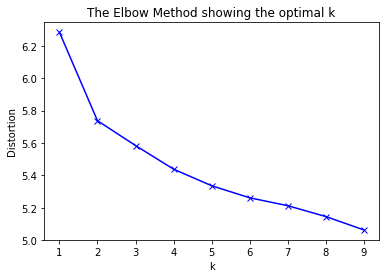

In [40]:
#this clearly shows that we are looking for two classes in our data set. Mental Model
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist

# k means determine k
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(X[num_data])
    kmeanModel.fit(X[num_data])
    distortions.append(sum(np.min(cdist(X[num_data], kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / X[num_data].shape[0])

# Plot the elbow
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.savefig("elbow.png")
plt.show()

In [41]:
from sklearn.metrics import classification_report
# create kmeans object
kmeans = KMeans(n_clusters=2, random_state= 123)
# fit kmeans object to data
kmeans.fit(X[num_data])

# save new clusters for chart
predicted1 = kmeans.fit_predict(X[num_data])
predicted1 = np.choose(predicted1, [0,1]).astype(int)
predicted1 = pd.DataFrame(predicted1, columns=['target'])

val_df = pd.concat([X[target], predicted1],axis=1)

print(classification_report(val_df['churn'], val_df['target']))
pd.crosstab(val_df['churn'], val_df['target'])

             precision    recall  f1-score   support

      False       0.86      0.50      0.63      2850
       True       0.15      0.51      0.23       483

avg / total       0.75      0.50      0.57      3333



target,0,1
churn,,
False,1419,1431
True,236,247


## 4.2 Supervised Approach

In [42]:
## first make a model function for modeling with confusion matrix
#During a classification task, Confusion Matric brings about better insights as to what group should we target based on the problem.

from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report, confusion_matrix, roc_curve, precision_recall_curve, average_precision_score, precision_recall_fscore_support
from sklearn.metrics import roc_auc_score, auc

def report_model(model,features_train,features_test,labels_train,labels_test):
    clf= model
    clf.fit(features_train,labels_train.values.ravel())
    pred=clf.predict(features_test)
    cnf_matrix=confusion_matrix(labels_test,pred)
    print("the recall for this model is :",cnf_matrix[1,1]/(cnf_matrix[1,1]+cnf_matrix[1,0]))
    fig= plt.figure(figsize=(6,3))# to plot the graph
    print("TP",cnf_matrix[1,1,]) # no of fraud transaction which are predicted fraud
    print("TN",cnf_matrix[0,0]) # no. of normal transaction which are predited normal
    print("FP",cnf_matrix[0,1]) # no of normal transaction which are predicted fraud
    print("FN",cnf_matrix[1,0]) # no of fraud Transaction which are predicted normal
    sns.heatmap(cnf_matrix,cmap="coolwarm_r",annot=True,linewidths=0.5)
    plt.title("Confusion_matrix")
    plt.xlabel("Predicted_class")
    plt.ylabel("Real class")
    plt.show()
    print("\n----------Classification Report------------------------------------")
    print(classification_report(labels_test,pred))

In [43]:
#Data Split 70:30
from sklearn.cross_validation import train_test_split

train, test = sklearn.cross_validation.train_test_split(X, train_size = 0.7, random_state=123)

In [44]:
train_x = train[num_data]
test_x = test[num_data]

train_y =train[target]
test_y =test[target]

In [45]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn import svm
from sklearn.ensemble import GradientBoostingClassifier

classifiers = [
    KNeighborsClassifier(n_jobs = 20),
    RandomForestClassifier(n_jobs = 20),
    GaussianNB(),
    LogisticRegression(n_jobs= 5, random_state=123),
    LogisticRegressionCV(random_state=111, n_jobs=50),
    DecisionTreeClassifier(criterion='gini'),
    DecisionTreeClassifier(criterion='entropy'),
    RandomForestClassifier(max_depth=100, random_state=123, n_jobs=20, n_estimators=120),
    svm.SVC(random_state=123, kernel='rbf',probability=True),
    GradientBoostingClassifier(n_estimators=100, learning_rate=1.0, max_depth=1, random_state=123)
]

KNeighborsClassifier
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=20, n_neighbors=5, p=2,
           weights='uniform')
the recall for this model is : 0.3383458646616541
TP 45
TN 852
FP 15
FN 88


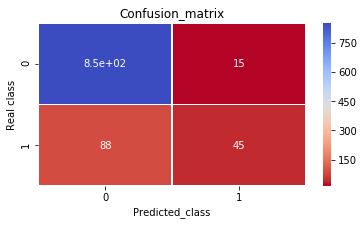


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.91      0.98      0.94       867
       True       0.75      0.34      0.47       133

avg / total       0.89      0.90      0.88      1000



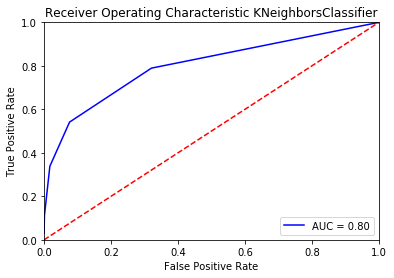

Score:  0.897 
Accuracy score:  0.897 
F1 score:  0.466 
- - - - -  

RandomForestClassifier
RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=20,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)
the recall for this model is : 0.7518796992481203
TP 100
TN 864
FP 3
FN 33


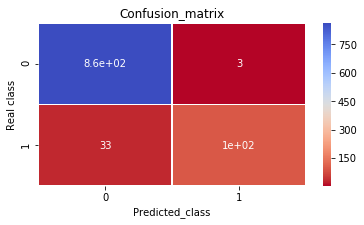


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.96      1.00      0.98       867
       True       0.97      0.75      0.85       133

avg / total       0.96      0.96      0.96      1000



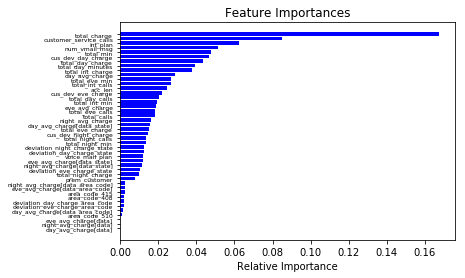

<Figure size 1440x2880 with 0 Axes>

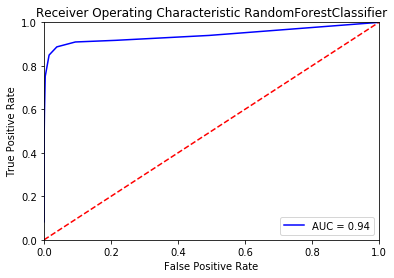

Score:  0.971 
Accuracy score:  0.971 
F1 score:  0.879 
- - - - -  

GaussianNB
GaussianNB(priors=None)
the recall for this model is : 0.6691729323308271
TP 89
TN 763
FP 104
FN 44


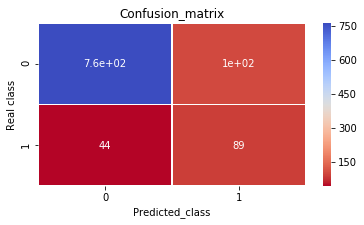


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.95      0.88      0.91       867
       True       0.46      0.67      0.55       133

avg / total       0.88      0.85      0.86      1000



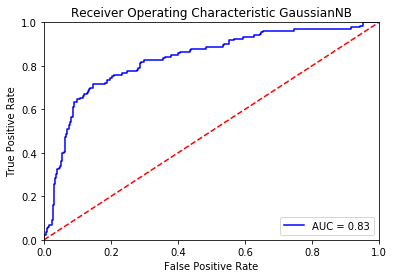

Score:  0.852 
Accuracy score:  0.852 
F1 score:  0.546 
- - - - -  

LogisticRegression
LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=5,
          penalty='l2', random_state=123, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)
the recall for this model is : 0.24060150375939848
TP 32
TN 832
FP 35
FN 101


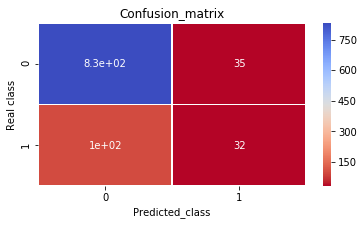


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.89      0.96      0.92       867
       True       0.48      0.24      0.32       133

avg / total       0.84      0.86      0.84      1000



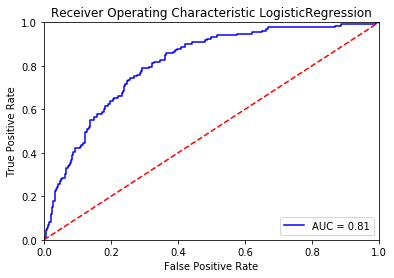

Score:  0.864 
Accuracy score:  0.864 
F1 score:  0.32 
- - - - -  

LogisticRegressionCV
LogisticRegressionCV(Cs=10, class_weight=None, cv=None, dual=False,
           fit_intercept=True, intercept_scaling=1.0, max_iter=100,
           multi_class='ovr', n_jobs=50, penalty='l2', random_state=111,
           refit=True, scoring=None, solver='lbfgs', tol=0.0001, verbose=0)
the recall for this model is : 0.22556390977443608
TP 30
TN 834
FP 33
FN 103


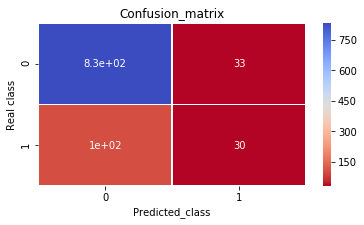


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.89      0.96      0.92       867
       True       0.48      0.23      0.31       133

avg / total       0.84      0.86      0.84      1000



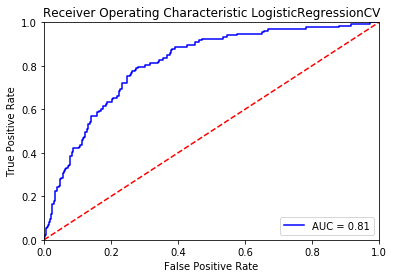

Score:  0.864 
Accuracy score:  0.864 
F1 score:  0.306 
- - - - -  

DecisionTreeClassifier
DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')
the recall for this model is : 0.8947368421052632
TP 119
TN 844
FP 23
FN 14


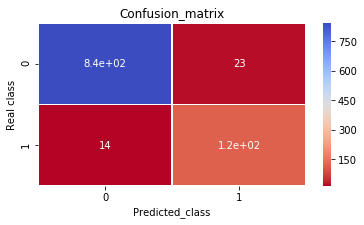


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.98      0.97      0.98       867
       True       0.84      0.89      0.87       133

avg / total       0.96      0.96      0.96      1000



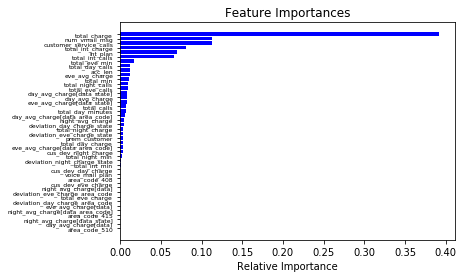

<Figure size 1440x2880 with 0 Axes>

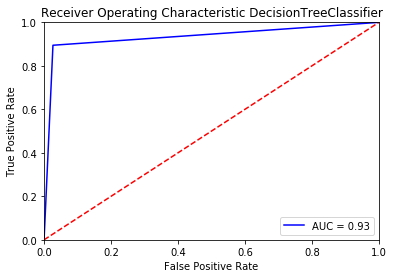

Score:  0.96 
Accuracy score:  0.96 
F1 score:  0.857 
- - - - -  

DecisionTreeClassifier
DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')
the recall for this model is : 0.9022556390977443
TP 120
TN 830
FP 37
FN 13


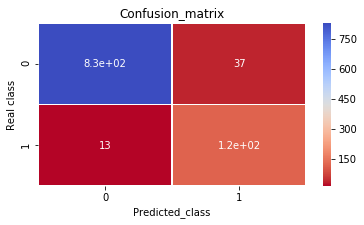


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.98      0.96      0.97       867
       True       0.76      0.90      0.83       133

avg / total       0.96      0.95      0.95      1000



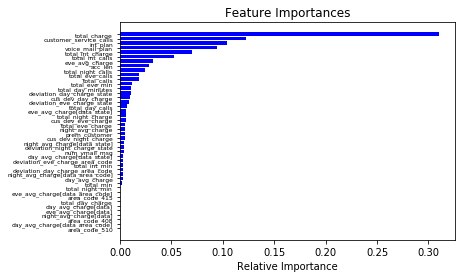

<Figure size 1440x2880 with 0 Axes>

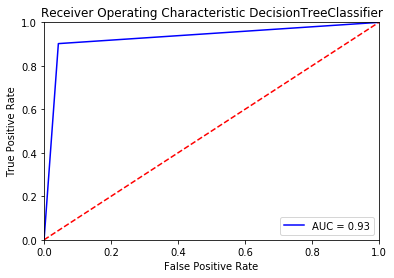

Score:  0.957 
Accuracy score:  0.957 
F1 score:  0.848 
- - - - -  

RandomForestClassifier
RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=100, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=120, n_jobs=20,
            oob_score=False, random_state=123, verbose=0, warm_start=False)
the recall for this model is : 0.8571428571428571
TP 114
TN 867
FP 0
FN 19


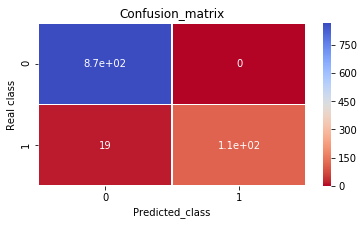


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.98      1.00      0.99       867
       True       1.00      0.86      0.92       133

avg / total       0.98      0.98      0.98      1000



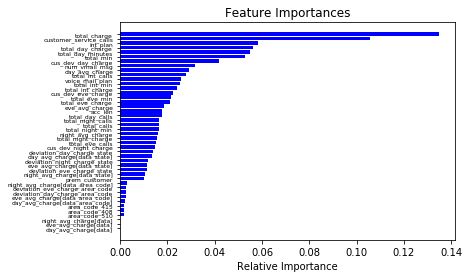

<Figure size 1440x2880 with 0 Axes>

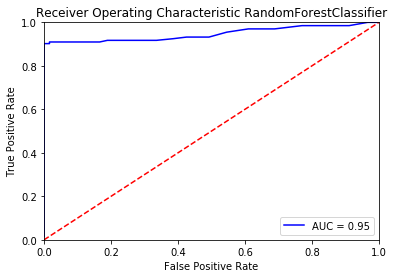

Score:  0.981 
Accuracy score:  0.981 
F1 score:  0.923 
- - - - -  

SVC
SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=True, random_state=123, shrinking=True,
  tol=0.001, verbose=False)
the recall for this model is : 0.44360902255639095
TP 59
TN 857
FP 10
FN 74


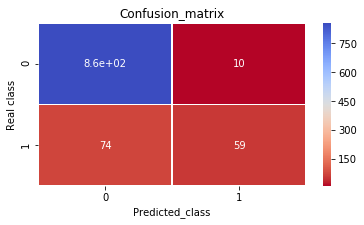


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.92      0.99      0.95       867
       True       0.86      0.44      0.58       133

avg / total       0.91      0.92      0.90      1000



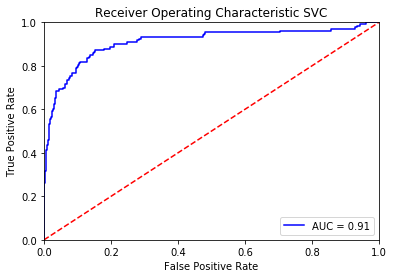

Score:  0.916 
Accuracy score:  0.916 
F1 score:  0.584 
- - - - -  

GradientBoostingClassifier
GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=1.0, loss='deviance', max_depth=1,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_samples_split=2,
              min_weight_fraction_leaf=0.0, n_estimators=100,
              presort='auto', random_state=123, subsample=1.0, verbose=0,
              warm_start=False)
the recall for this model is : 0.39097744360902253
TP 52
TN 848
FP 19
FN 81


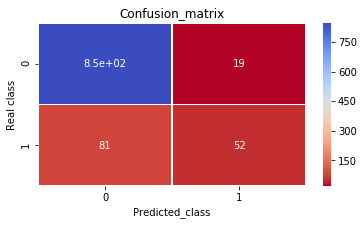


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.91      0.98      0.94       867
       True       0.73      0.39      0.51       133

avg / total       0.89      0.90      0.89      1000



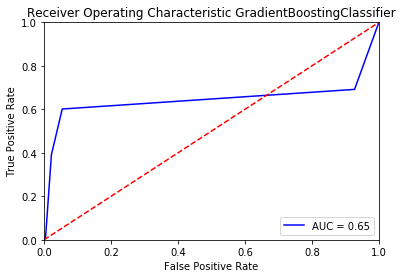

Score:  0.9 
Accuracy score:  0.9 
F1 score:  0.51 
- - - - -  



In [46]:
# iterate over classifiers
for item in classifiers:
    classifier_name = ((str(item)[:(str(item).find("("))]))
    print (classifier_name)
    
    # Create classifier, train it and test it.
    clf = item
    print(item)
    
    clf.fit(train_x, train_y)
    pred = clf.predict(test_x)
    score = clf.score(test_x, test_y)
    report_model(clf, train_x, test_x, train_y,test_y)
    
    if classifier_name in ["RandomForestClassifier", 'DecisionTreeClassifier']:
        %matplotlib inline
        import matplotlib.pyplot as plt
        import numpy as np
        features = train_x.columns

        importances = clf.feature_importances_
        indices = np.argsort(importances)
        plt.title('Feature Importances')
        plt.barh(range(len(indices)), importances[indices], color='b', align='center')
        plt.yticks(range(len(indices)), [features[i] for i in indices], fontsize = 6)
        plt.xlabel('Relative Importance')
        plt.figure(figsize=(20,40))
        plt.savefig(classifier_name+ "_feature_imp.png")
        plt.show()
    
    
    # calculate the fpr and tpr for all thresholds of the classification
    probs = clf.predict_proba(test_x)
    preds = probs[:,1]
    fpr, tpr, threshold = roc_curve(test_y, preds)
    roc_auc = auc(fpr, tpr)

    plt.title('Receiver Operating Characteristic '+classifier_name)
    plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.savefig(classifier_name+ "_roc_auc.png")
    plt.show()

    print ("Score: ", round(score,3),"\nAccuracy score: ", round(accuracy_score(test_y, pred), 3),"\nF1 score: ", round(f1_score(test_y, pred), 3), "\n- - - - - ", "\n")

In [47]:
#Hyper Parameter Tuning with Grid Search and classifier as Random Forest
from sklearn.model_selection import GridSearchCV
model = RandomForestClassifier(random_state=42)

param_grid = [{'n_estimators': [3, 10, 30, 100, 500,1000], 'max_features': ['auto', 'sqrt', 'log2', 2, 4, 6, 8],'max_leaf_nodes': [2,4,6,8,16]}, 
{'bootstrap': [False], 'n_estimators': [3, 10, 20],
 'max_depth' : [4,5,6,7,8],
    'criterion' :['gini', 'entropy']},]

clf = GridSearchCV(model, param_grid, cv=5, scoring='accuracy')
clf.fit(train_x, train_y)
# view accuracy scores for all the models
print("Grid scores for all the models based on CV:\n")
means = clf.cv_results_['mean_test_score']
stds = clf.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, clf.cv_results_['params']):
    print("%0.5f (+/-%0.05f) for %r" % (mean, std * 2, params))
# check out best model performance
print("\nBest parameters set found on development set:", clf.best_params_)
print("Best model validation accuracy:", clf.best_score_)

Grid scores for all the models based on CV:

0.84869 (+/-0.00461) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 3}
0.84998 (+/-0.00032) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 10}
0.84998 (+/-0.00032) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 30}
0.84998 (+/-0.00032) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 100}
0.84998 (+/-0.00032) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 500}
0.84998 (+/-0.00032) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 1000}
0.86069 (+/-0.01686) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 3}
0.85898 (+/-0.01318) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 10}
0.87184 (+/-0.01173) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 30}
0.87784 (+/-0.01712) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 100}
0.87913 (+/-0.01563) for {'max_features': 

we are not observing great accuracies with default parameters; this can be a possible implication of class imbalance 
problem, we need to explore better ways to handle this. I hope to have this issue tackled by cross validation. We need to 
create more observations to help the model learn the pattern for the class which is in minority.

This can be dealt in two ways:
    - either decrease the samples for majority class
        Issue: as there are less samples for minority class, decreasing the samples for majority class would do less good.
            
    - Synthetically increase/generate new samples for minority class

In [48]:
## Class Imbalance Issue - synthetically generating samples for minority class observations
# smote uses k nearest neighbour technique to generate samples for minority class samples

! pip install imblearn
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=123, ratio = 1)

train_x, train_y = sm.fit_sample(train[num_data], train[target])

train_x = pd.DataFrame(train_x, columns=num_data)
train_y = pd.DataFrame(train_y, columns=target)

KNeighborsClassifier
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=20, n_neighbors=5, p=2,
           weights='uniform')
the recall for this model is : 0.7593984962406015
TP 101
TN 670
FP 197
FN 32


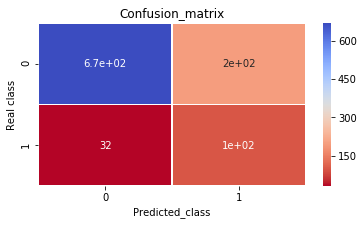


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.95      0.77      0.85       867
       True       0.34      0.76      0.47       133

avg / total       0.87      0.77      0.80      1000



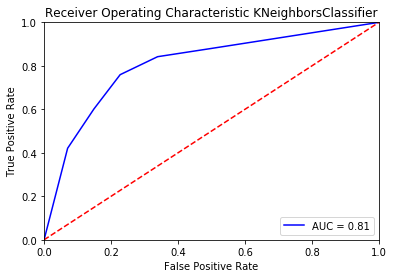

Score:  0.771 
Accuracy score:  0.771 
F1 score:  0.469 
- - - - -  

RandomForestClassifier
RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=20,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)
the recall for this model is : 0.7744360902255639
TP 103
TN 855
FP 12
FN 30


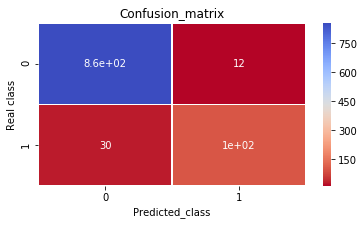


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.97      0.99      0.98       867
       True       0.90      0.77      0.83       133

avg / total       0.96      0.96      0.96      1000



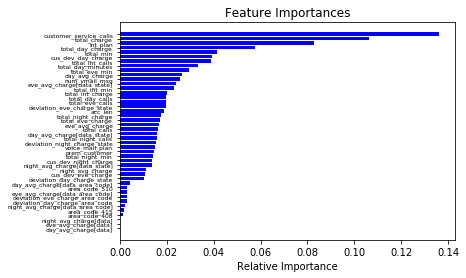

<Figure size 1440x2880 with 0 Axes>

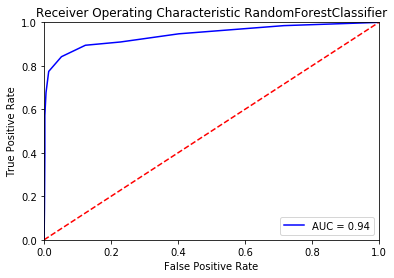

Score:  0.964 
Accuracy score:  0.964 
F1 score:  0.862 
- - - - -  

GaussianNB
GaussianNB(priors=None)
the recall for this model is : 0.6917293233082706
TP 92
TN 695
FP 172
FN 41


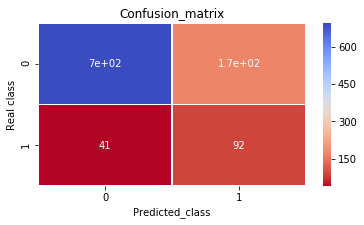


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.94      0.80      0.87       867
       True       0.35      0.69      0.46       133

avg / total       0.87      0.79      0.81      1000



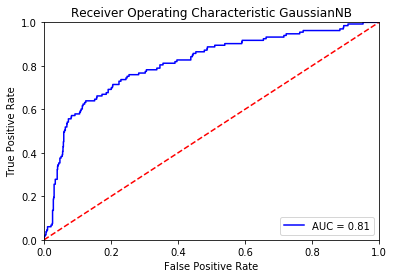

Score:  0.787 
Accuracy score:  0.787 
F1 score:  0.463 
- - - - -  

LogisticRegression
LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=5,
          penalty='l2', random_state=123, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)
the recall for this model is : 0.6842105263157895
TP 91
TN 656
FP 211
FN 42


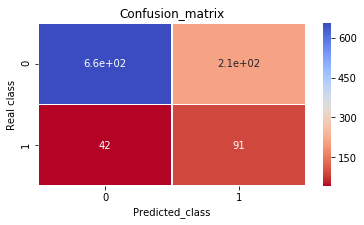


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.94      0.76      0.84       867
       True       0.30      0.68      0.42       133

avg / total       0.85      0.75      0.78      1000



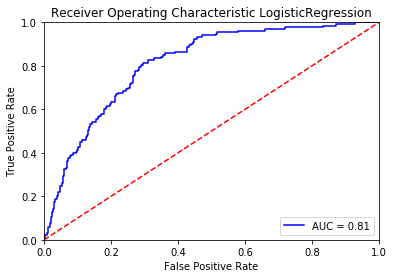

Score:  0.747 
Accuracy score:  0.747 
F1 score:  0.418 
- - - - -  

LogisticRegressionCV
LogisticRegressionCV(Cs=10, class_weight=None, cv=None, dual=False,
           fit_intercept=True, intercept_scaling=1.0, max_iter=100,
           multi_class='ovr', n_jobs=50, penalty='l2', random_state=111,
           refit=True, scoring=None, solver='lbfgs', tol=0.0001, verbose=0)
the recall for this model is : 0.6842105263157895
TP 91
TN 656
FP 211
FN 42


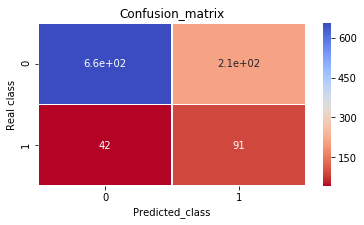


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.94      0.76      0.84       867
       True       0.30      0.68      0.42       133

avg / total       0.85      0.75      0.78      1000



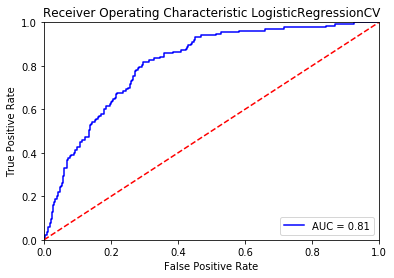

Score:  0.747 
Accuracy score:  0.747 
F1 score:  0.418 
- - - - -  

DecisionTreeClassifier
DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')
the recall for this model is : 0.9097744360902256
TP 121
TN 816
FP 51
FN 12


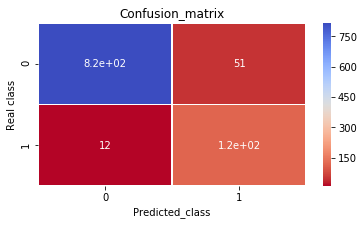


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.99      0.94      0.96       867
       True       0.70      0.91      0.79       133

avg / total       0.95      0.94      0.94      1000



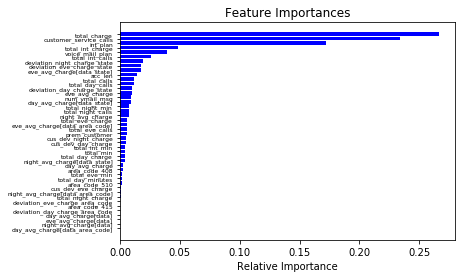

<Figure size 1440x2880 with 0 Axes>

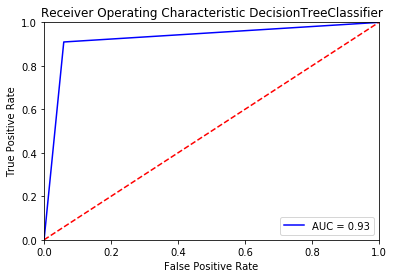

Score:  0.936 
Accuracy score:  0.936 
F1 score:  0.789 
- - - - -  

DecisionTreeClassifier
DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')
the recall for this model is : 0.9097744360902256
TP 121
TN 823
FP 44
FN 12


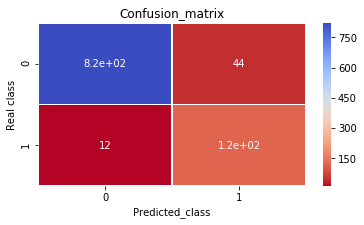


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.99      0.95      0.97       867
       True       0.73      0.91      0.81       133

avg / total       0.95      0.94      0.95      1000



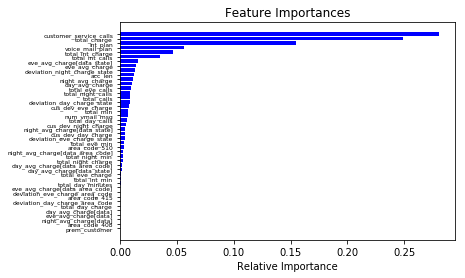

<Figure size 1440x2880 with 0 Axes>

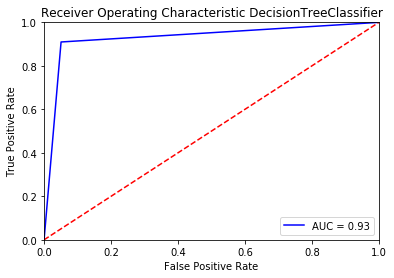

Score:  0.942 
Accuracy score:  0.942 
F1 score:  0.808 
- - - - -  

RandomForestClassifier
RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=100, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=120, n_jobs=20,
            oob_score=False, random_state=123, verbose=0, warm_start=False)
the recall for this model is : 0.8646616541353384
TP 115
TN 855
FP 12
FN 18


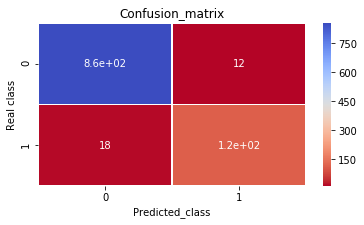


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.98      0.99      0.98       867
       True       0.91      0.86      0.88       133

avg / total       0.97      0.97      0.97      1000



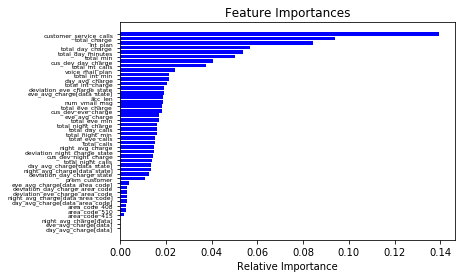

<Figure size 1440x2880 with 0 Axes>

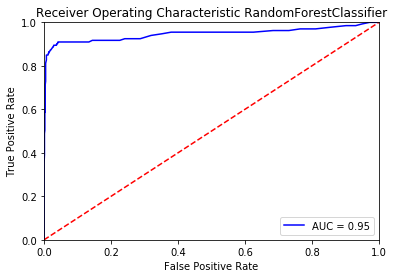

Score:  0.97 
Accuracy score:  0.97 
F1 score:  0.885 
- - - - -  

SVC
SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=True, random_state=123, shrinking=True,
  tol=0.001, verbose=False)
the recall for this model is : 0.706766917293233
TP 94
TN 788
FP 79
FN 39


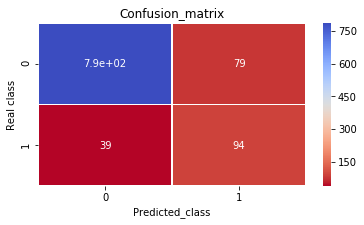


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.95      0.91      0.93       867
       True       0.54      0.71      0.61       133

avg / total       0.90      0.88      0.89      1000



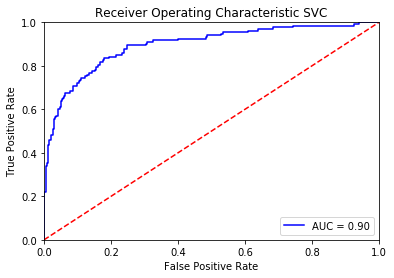

Score:  0.882 
Accuracy score:  0.882 
F1 score:  0.614 
- - - - -  

GradientBoostingClassifier
GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=1.0, loss='deviance', max_depth=1,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_samples_split=2,
              min_weight_fraction_leaf=0.0, n_estimators=100,
              presort='auto', random_state=123, subsample=1.0, verbose=0,
              warm_start=False)
the recall for this model is : 0.7593984962406015
TP 101
TN 797
FP 70
FN 32


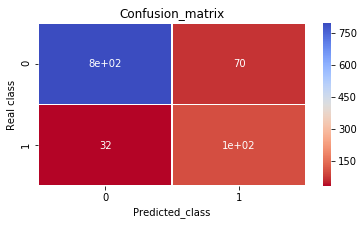


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.96      0.92      0.94       867
       True       0.59      0.76      0.66       133

avg / total       0.91      0.90      0.90      1000



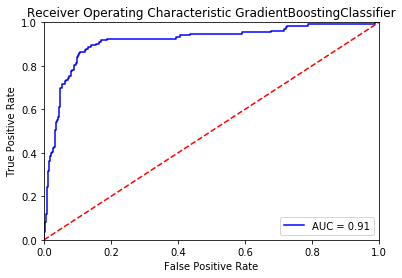

Score:  0.898 
Accuracy score:  0.898 
F1 score:  0.664 
- - - - -  



In [49]:
# iterate over classifiers
for item in classifiers:
    classifier_name = ((str(item)[:(str(item).find("("))]))
    print (classifier_name)
    
    # Create classifier, train it and test it.
    clf = item
    print(item)
    
    clf.fit(train_x, train_y)
    pred = clf.predict(test_x)
    score = clf.score(test_x, test_y)
    report_model(clf, train_x, test_x, train_y,test_y)
    
    if classifier_name in ["RandomForestClassifier", 'DecisionTreeClassifier']:
        %matplotlib inline
        import matplotlib.pyplot as plt
        import numpy as np
        features = train_x.columns

        importances = clf.feature_importances_
        indices = np.argsort(importances)
        plt.title('Feature Importances')
        plt.barh(range(len(indices)), importances[indices], color='b', align='center')
        plt.yticks(range(len(indices)), [features[i] for i in indices], fontsize = 6)
        plt.xlabel('Relative Importance')
        plt.figure(figsize=(20,40))
        plt.savefig(classifier_name+ "_feature_imp.png")
        plt.show()
    
    
    # calculate the fpr and tpr for all thresholds of the classification
    probs = clf.predict_proba(test_x)
    preds = probs[:,1]
    fpr, tpr, threshold = roc_curve(test_y, preds)
    roc_auc = auc(fpr, tpr)

    plt.title('Receiver Operating Characteristic '+classifier_name)
    plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.savefig(classifier_name+ "_roc_auc.png")
    plt.show()

    print ("Score: ", round(score,3),"\nAccuracy score: ", round(accuracy_score(test_y, pred), 3),"\nF1 score: ", round(f1_score(test_y, pred), 3), "\n- - - - - ", "\n")

In [50]:
#Hyper Parameter Tuning with Grid Search and classifier as Random Forest
from sklearn.model_selection import GridSearchCV
model = RandomForestClassifier(random_state=42)

param_grid = [{'n_estimators': [3, 10, 30, 100, 500,1000], 'max_features': ['auto', 'sqrt', 'log2', 2, 4, 6, 8],'max_leaf_nodes': [2,4,6,8,16]}, 
{'bootstrap': [False], 'n_estimators': [3, 10, 20],
 'max_depth' : [4,5,6,7,8],
    'criterion' :['gini', 'entropy']},]

clf = GridSearchCV(model, param_grid, cv=5, scoring='accuracy')
clf.fit(train_x, train_y)
# view accuracy scores for all the models
print("Grid scores for all the models based on CV:\n")
means = clf.cv_results_['mean_test_score']
stds = clf.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, clf.cv_results_['params']):
    print("%0.5f (+/-%0.05f) for %r" % (mean, std * 2, params))
# check out best model performance
print("\nBest parameters set found on development set:", clf.best_params_)
print("Best model validation accuracy:", clf.best_score_)

Grid scores for all the models based on CV:

0.73323 (+/-0.01464) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 3}
0.68356 (+/-0.01478) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 10}
0.66919 (+/-0.01061) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 30}
0.67726 (+/-0.01071) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 100}
0.67801 (+/-0.01237) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 500}
0.68129 (+/-0.00922) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 1000}
0.75088 (+/-0.01894) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 3}
0.76702 (+/-0.01877) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 10}
0.75038 (+/-0.03907) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 30}
0.79627 (+/-0.04720) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 100}
0.81417 (+/-0.04505) for {'max_features': 

In [51]:
#SMOTE 2

sm = SMOTE(random_state=123, ratio = 1)

Z_x, Z_y = sm.fit_sample(data[num_data], data[target])

Z_x = pd.DataFrame(Z_x, columns=num_data)
Z_y = pd.DataFrame(Z_y, columns=target)

In [52]:
X = pd.concat([Z_x,Z_y],axis=1)

In [53]:
#Data Split 70:30
from sklearn.cross_validation import train_test_split

train, test = sklearn.cross_validation.train_test_split(X, train_size = 0.7, random_state=123)

In [54]:
train_x = train[num_data]
test_x = test[num_data]

train_y =train[target]
test_y =test[target]

KNeighborsClassifier
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=20, n_neighbors=5, p=2,
           weights='uniform')
the recall for this model is : 0.9594438006952491
TP 828
TN 588
FP 260
FN 35


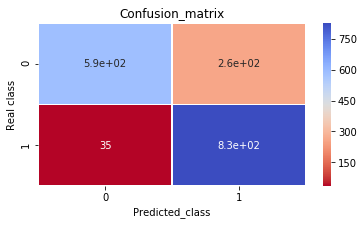


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.94      0.69      0.80       848
       True       0.76      0.96      0.85       863

avg / total       0.85      0.83      0.82      1711



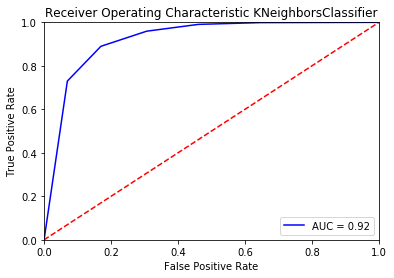

Score:  0.828 
Accuracy score:  0.828 
F1 score:  0.849 
- - - - -  

RandomForestClassifier
RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=20,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)
the recall for this model is : 0.9571263035921205
TP 826
TN 834
FP 14
FN 37


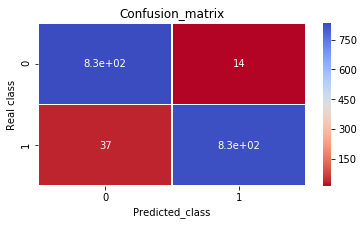


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.96      0.98      0.97       848
       True       0.98      0.96      0.97       863

avg / total       0.97      0.97      0.97      1711



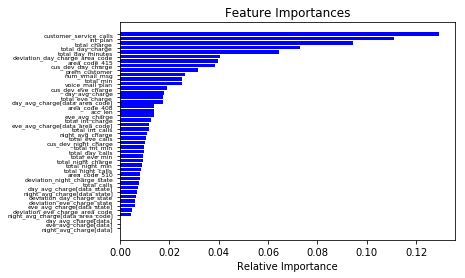

<Figure size 1440x2880 with 0 Axes>

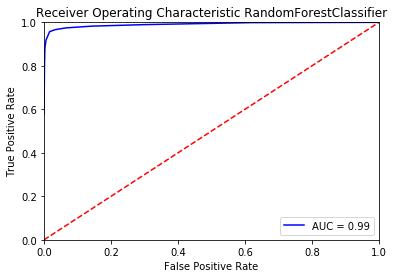

Score:  0.97 
Accuracy score:  0.97 
F1 score:  0.97 
- - - - -  

GaussianNB
GaussianNB(priors=None)
the recall for this model is : 0.7531865585168018
TP 650
TN 684
FP 164
FN 213


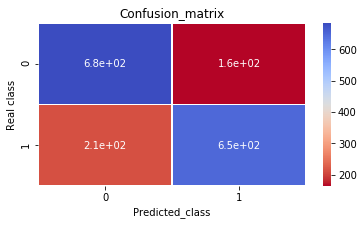


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.76      0.81      0.78       848
       True       0.80      0.75      0.78       863

avg / total       0.78      0.78      0.78      1711



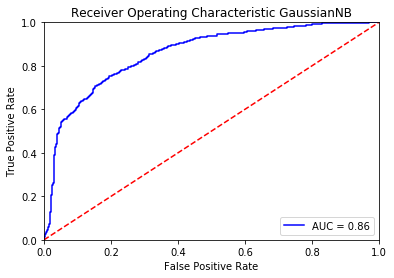

Score:  0.78 
Accuracy score:  0.78 
F1 score:  0.775 
- - - - -  

LogisticRegression
LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=5,
          penalty='l2', random_state=123, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)
the recall for this model is : 0.8157589803012746
TP 704
TN 655
FP 193
FN 159


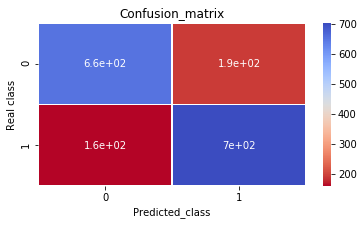


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.80      0.77      0.79       848
       True       0.78      0.82      0.80       863

avg / total       0.79      0.79      0.79      1711



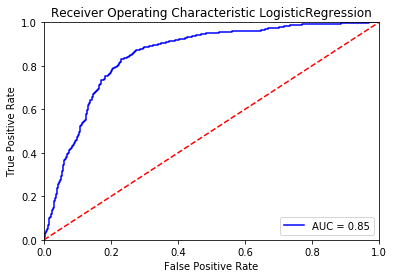

Score:  0.794 
Accuracy score:  0.794 
F1 score:  0.8 
- - - - -  

LogisticRegressionCV
LogisticRegressionCV(Cs=10, class_weight=None, cv=None, dual=False,
           fit_intercept=True, intercept_scaling=1.0, max_iter=100,
           multi_class='ovr', n_jobs=50, penalty='l2', random_state=111,
           refit=True, scoring=None, solver='lbfgs', tol=0.0001, verbose=0)
the recall for this model is : 0.8088064889918888
TP 698
TN 652
FP 196
FN 165


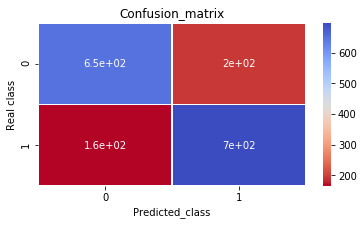


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.80      0.77      0.78       848
       True       0.78      0.81      0.79       863

avg / total       0.79      0.79      0.79      1711



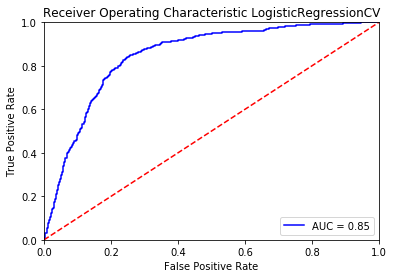

Score:  0.789 
Accuracy score:  0.789 
F1 score:  0.795 
- - - - -  

DecisionTreeClassifier
DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')
the recall for this model is : 0.9501738122827347
TP 820
TN 788
FP 60
FN 43


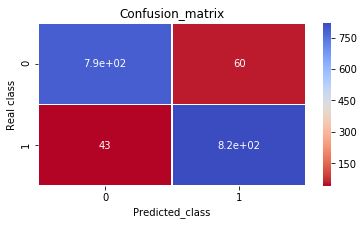


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.95      0.93      0.94       848
       True       0.93      0.95      0.94       863

avg / total       0.94      0.94      0.94      1711



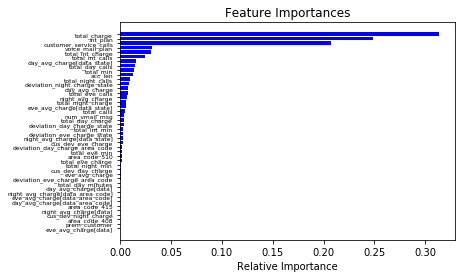

<Figure size 1440x2880 with 0 Axes>

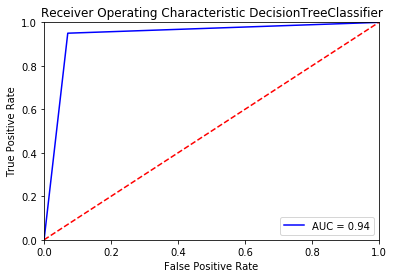

Score:  0.943 
Accuracy score:  0.943 
F1 score:  0.944 
- - - - -  

DecisionTreeClassifier
DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')
the recall for this model is : 0.9582850521436849
TP 827
TN 806
FP 42
FN 36


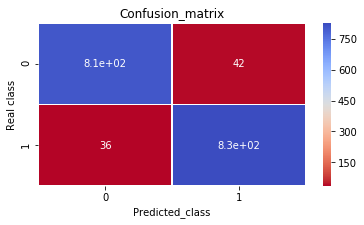


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.96      0.95      0.95       848
       True       0.95      0.96      0.95       863

avg / total       0.95      0.95      0.95      1711



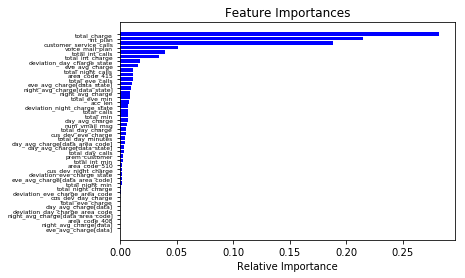

<Figure size 1440x2880 with 0 Axes>

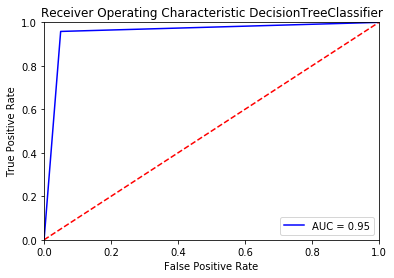

Score:  0.956 
Accuracy score:  0.956 
F1 score:  0.957 
- - - - -  

RandomForestClassifier
RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=100, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=120, n_jobs=20,
            oob_score=False, random_state=123, verbose=0, warm_start=False)
the recall for this model is : 0.9698725376593279
TP 837
TN 837
FP 11
FN 26


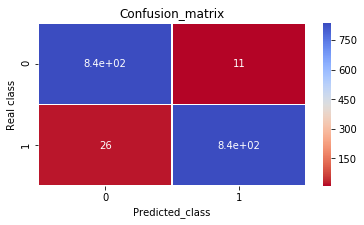


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.97      0.99      0.98       848
       True       0.99      0.97      0.98       863

avg / total       0.98      0.98      0.98      1711



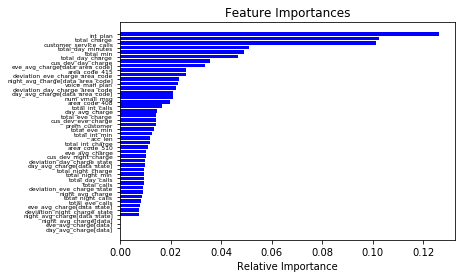

<Figure size 1440x2880 with 0 Axes>

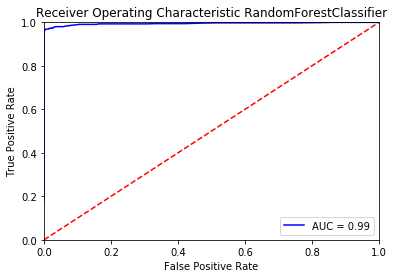

Score:  0.978 
Accuracy score:  0.978 
F1 score:  0.978 
- - - - -  

SVC
SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
  max_iter=-1, probability=True, random_state=123, shrinking=True,
  tol=0.001, verbose=False)
the recall for this model is : 0.4519119351100811
TP 390
TN 848
FP 0
FN 473


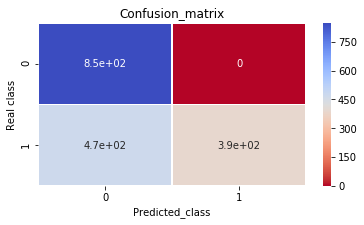


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.64      1.00      0.78       848
       True       1.00      0.45      0.62       863

avg / total       0.82      0.72      0.70      1711



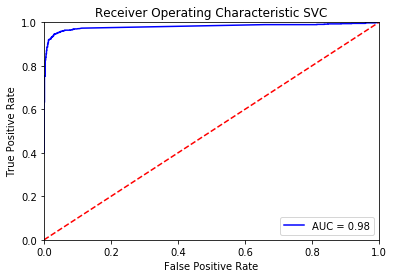

Score:  0.724 
Accuracy score:  0.724 
F1 score:  0.623 
- - - - -  

GradientBoostingClassifier
GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=1.0, loss='deviance', max_depth=1,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_samples_split=2,
              min_weight_fraction_leaf=0.0, n_estimators=100,
              presort='auto', random_state=123, subsample=1.0, verbose=0,
              warm_start=False)
the recall for this model is : 0.93279258400927
TP 805
TN 804
FP 44
FN 58


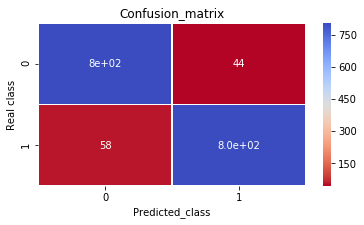


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.93      0.95      0.94       848
       True       0.95      0.93      0.94       863

avg / total       0.94      0.94      0.94      1711



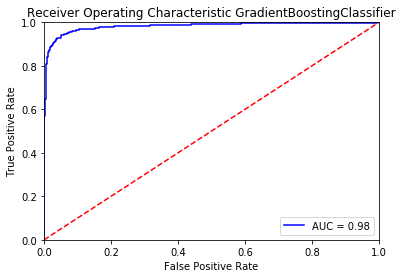

Score:  0.94 
Accuracy score:  0.94 
F1 score:  0.94 
- - - - -  



In [55]:
# iterate over classifiers
for item in classifiers:
    classifier_name = ((str(item)[:(str(item).find("("))]))
    print (classifier_name)
    
    # Create classifier, train it and test it.
    clf = item
    print(item)
    
    clf.fit(train_x, train_y)
    pred = clf.predict(test_x)
    score = clf.score(test_x, test_y)
    report_model(clf, train_x, test_x, train_y,test_y)
    
    if classifier_name in ["RandomForestClassifier", 'DecisionTreeClassifier']:
        %matplotlib inline
        import matplotlib.pyplot as plt
        import numpy as np
        features = train_x.columns

        importances = clf.feature_importances_
        indices = np.argsort(importances)
        plt.title('Feature Importances')
        plt.barh(range(len(indices)), importances[indices], color='b', align='center')
        plt.yticks(range(len(indices)), [features[i] for i in indices], fontsize = 6)
        plt.xlabel('Relative Importance')
        plt.figure(figsize=(20,40))
        plt.savefig(classifier_name+ "_feature_imp.png")
        plt.show()
    
    
    # calculate the fpr and tpr for all thresholds of the classification
    probs = clf.predict_proba(test_x)
    preds = probs[:,1]
    fpr, tpr, threshold = roc_curve(test_y, preds)
    roc_auc = auc(fpr, tpr)

    plt.title('Receiver Operating Characteristic '+classifier_name)
    plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.savefig(classifier_name+ "_roc_auc.png")
    plt.show()

    print ("Score: ", round(score,3),"\nAccuracy score: ", round(accuracy_score(test_y, pred), 3),"\nF1 score: ", round(f1_score(test_y, pred), 3), "\n- - - - - ", "\n")

In [56]:
#Hyper Parameter Tuning with Grid Search and classifier as Random Forest
model = RandomForestClassifier(random_state=42)

param_grid = [{'n_estimators': [3, 10, 30, 100, 500,1000], 'max_features': ['auto', 'sqrt', 'log2', 2, 4, 6, 8],'max_leaf_nodes': [2,4,6,8,16]}, 
{'bootstrap': [False], 'n_estimators': [3, 10, 20],
 'max_depth' : [4,5,6,7,8],
    'criterion' :['gini', 'entropy']},]

clf = GridSearchCV(model, param_grid, cv=5, scoring='accuracy')
clf.fit(train_x, train_y)
# view accuracy scores for all the models
print("Grid scores for all the models based on CV:\n")
means = clf.cv_results_['mean_test_score']
stds = clf.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, clf.cv_results_['params']):
    print("%0.5f (+/-%0.05f) for %r" % (mean, std * 2, params))
# check out best model performance
print("\nBest parameters set found on development set:", clf.best_params_)
print("Best model validation accuracy:", clf.best_score_)

Grid scores for all the models based on CV:

0.77839 (+/-0.02392) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 3}
0.76636 (+/-0.02293) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 10}
0.76886 (+/-0.02125) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 30}
0.78215 (+/-0.01738) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 100}
0.77814 (+/-0.02854) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 500}
0.78716 (+/-0.02576) for {'max_features': 'auto', 'max_leaf_nodes': 2, 'n_estimators': 1000}
0.80998 (+/-0.05849) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 3}
0.84357 (+/-0.00819) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 10}
0.84758 (+/-0.03152) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 30}
0.86062 (+/-0.01624) for {'max_features': 'auto', 'max_leaf_nodes': 4, 'n_estimators': 100}
0.86538 (+/-0.01789) for {'max_features': 

# Model Selection & Validation

Best parameters set found on development set: {'bootstrap': False, 'criterion': 'entropy', 'max_depth': 8, 'n_estimators': 10}
Best model validation accuracy: 0.944706386626661

In [57]:
data = data.fillna(0)
final_data = data.copy()
final_data = final_data.fillna(0)
Z = final_data.copy()
Z.head()

,id,state,acc_len,area_code,int_plan,voice_mail_plan,num_vmail_msg,total_day_minutes,total_day_calls,total_day_charge,...,eve_avg_charge[data_area_code],night_avg_charge[data_area_code],deviation_day_charge_state,deviation_eve_charge_state,deviation_night_charge_state,deviation_day_charge_area_code,deviation_eve_charge_area_code,cus_dev_day_charge,cus_dev_eve_charge,cus_dev_night_charge
0,CUST-1,KS,128,415,0,1,25,265.1,110,45.07,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,0.474692,-0.017768,0.218011
1,CUST-369,KS,132,415,0,0,0,83.4,110,14.18,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,-0.536030,0.155498,-0.269857
2,CUST-380,KS,127,415,0,0,0,221.0,100,37.57,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,0.229292,-0.200400,0.160485
3,CUST-386,KS,137,415,0,0,0,230.2,113,39.13,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,0.280335,0.096377,0.018881
4,CUST-620,KS,110,415,1,0,0,293.3,79,49.86,...,17.055571,9.091795,0.065533,0.007611,0.015436,0.010111,0.005805,0.631421,-0.062255,0.328639


In [58]:
#Data Split 70:30
from sklearn.cross_validation import train_test_split

train, test = sklearn.cross_validation.train_test_split(Z, train_size = 0.7, random_state=123)

train_x = train[num_data]
test_x = test[num_data]

train_y =train[target]
test_y =test[target]

the recall for this model is : 0.7218045112781954
TP 96
TN 864
FP 3
FN 37


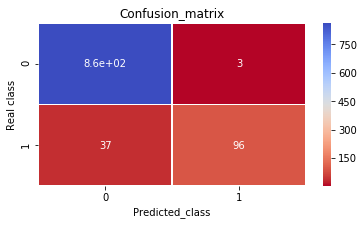


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.96      1.00      0.98       867
       True       0.97      0.72      0.83       133

avg / total       0.96      0.96      0.96      1000



In [59]:
clf = RandomForestClassifier(random_state=42, max_depth=8, n_estimators=10, criterion='entropy', bootstrap=False)

clf.fit(train_x, train_y)
pred = clf.predict(test_x)
score = clf.score(test_x, test_y)
report_model(clf, train_x, test_x, train_y,test_y)

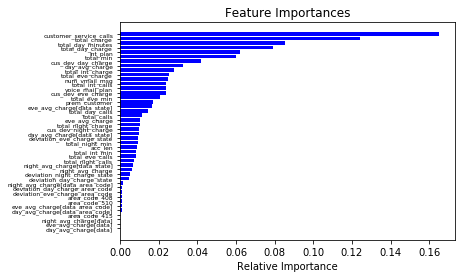

<Figure size 1440x2880 with 0 Axes>

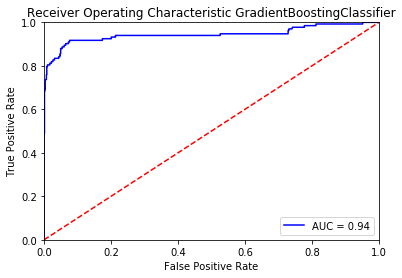

Score:  0.96 
Accuracy score:  0.96 
F1 score:  0.828 
- - - - -  



In [61]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
features = train_x.columns

importances = clf.feature_importances_
indices = np.argsort(importances)
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices], fontsize = 6)
plt.xlabel('Relative Importance')
plt.figure(figsize=(20,40))
plt.savefig(classifier_name+ "_feature_imp.png")
plt.show()


# calculate the fpr and tpr for all thresholds of the classification
probs = clf.predict_proba(test_x)
preds = probs[:,1]
fpr, tpr, threshold = roc_curve(test_y, preds)
roc_auc = auc(fpr, tpr)

plt.title('Receiver Operating Characteristic '+classifier_name)
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.savefig(classifier_name+ "_roc_auc.png")
plt.show()

print ("Score: ", round(score,3),"\nAccuracy score: ", round(accuracy_score(test_y, pred), 3),"\nF1 score: ", round(f1_score(test_y, pred), 3), "\n- - - - - ", "\n")

In [ ]:
#Best Model

the recall for this model is : 0.8571428571428571
TP 114
TN 867
FP 0
FN 19


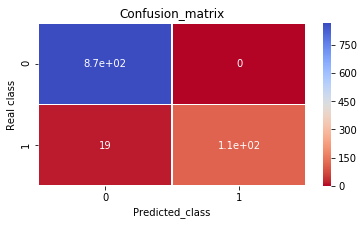


----------Classification Report------------------------------------
             precision    recall  f1-score   support

      False       0.98      1.00      0.99       867
       True       1.00      0.86      0.92       133

avg / total       0.98      0.98      0.98      1000



In [65]:
classifier_name = "RFC"
clf = RandomForestClassifier(max_depth=100, random_state=123, n_jobs=20, n_estimators=120)

clf.fit(train_x, train_y)
pred = clf.predict(test_x)
score = clf.score(test_x, test_y)
report_model(clf, train_x, test_x, train_y,test_y)

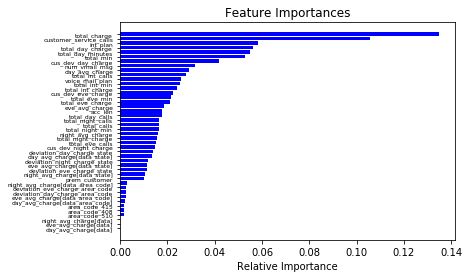

<Figure size 1440x2880 with 0 Axes>

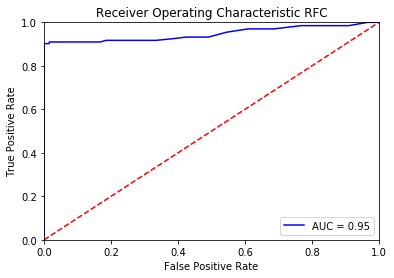

Score:  0.981 
Accuracy score:  0.981 
F1 score:  0.923 
- - - - -  



In [67]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
features = train_x.columns

importances = clf.feature_importances_
indices = np.argsort(importances)
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices], fontsize = 6)
plt.xlabel('Relative Importance')
plt.figure(figsize=(20,40))
plt.savefig(classifier_name+ "_feature_imp.png")
plt.show()


# calculate the fpr and tpr for all thresholds of the classification
probs = clf.predict_proba(test_x)
preds = probs[:,1]
fpr, tpr, threshold = roc_curve(test_y, preds)
roc_auc = auc(fpr, tpr)

plt.title('Receiver Operating Characteristic '+classifier_name)
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.savefig(classifier_name+ "_roc_auc.png")
plt.show()

print ("Score: ", round(score,3),"\nAccuracy score: ", round(accuracy_score(test_y, pred), 3),"\nF1 score: ", round(f1_score(test_y, pred), 3), "\n- - - - - ", "\n")